# Bankruptcy prediction

# Importing the dependencies

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.preprocessing import LabelEncoder

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn import tree
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

In [2]:
df= pd.read_csv("bankruptcy.csv")

In [3]:
df.head(20)

,company_name,status_label,year,current_assets,cogs,depreciation_&_amortization,ebitda,inventory,net_income,total_receivables,...,net_sales,total_assets,longterm_debt,ebit,gross_profit,current_liabilities,retained_earnings,total_revenue,total_liabilities,total_operating_expenses
0,C_1,alive,1999,511.267,833.107,18.373,89.031,336.018,35.163,128.348,...,1024.333,740.998,180.447,70.658,191.226,163.816,201.026,1024.333,401.483,935.302
1,C_1,alive,2000,485.856,713.811,18.577,64.367,320.590,18.531,115.187,...,874.255,701.854,179.987,45.790,160.444,125.392,204.065,874.255,361.642,809.888
2,C_1,alive,2001,436.656,526.477,22.496,27.207,286.588,-58.939,77.528,...,638.721,710.199,217.699,4.711,112.244,150.464,139.603,638.721,399.964,611.514
3,C_1,alive,2002,396.412,496.747,27.172,30.745,259.954,-12.410,66.322,...,606.337,686.621,164.658,3.573,109.590,203.575,124.106,606.337,391.633,575.592
4,C_1,alive,2003,432.204,523.302,26.680,47.491,247.245,3.504,104.661,...,651.958,709.292,248.666,20.811,128.656,131.261,131.884,651.958,407.608,604.467
5,C_1,alive,2004,474.542,598.172,27.950,61.774,255.477,15.453,127.121,...,747.848,732.230,227.159,33.824,149.676,160.025,142.450,747.848,417.486,686.074
6,C_1,alive,2005,624.454,704.081,29.222,91.877,323.592,35.163,136.272,...,897.284,978.819,318.576,62.655,193.203,187.788,183.550,897.284,556.102,805.407
7,C_1,alive,2006,645.721,837.171,32.199,118.907,342.593,58.660,181.691,...,1061.169,1067.633,253.611,86.708,223.998,256.506,242.153,1061.169,573.390,942.262
8,C_1,alive,2007,783.431,1080.895,39.952,168.522,435.608,75.144,202.472,...,1384.919,1362.010,507.918,128.570,304.024,218.499,318.184,1384.919,776.755,1216.397
9,C_1,alive,2008,851.312,1110.677,40.551,166.080,477.424,78.651,227.300,...,1423.976,1377.511,392.984,125.529,313.299,254.418,385.851,1423.976,720.616,1257.896


# Chapter 1: Understanding the Dataset

In [4]:
df.describe()

,year,current_assets,cogs,depreciation_&_amortization,ebitda,inventory,net_income,total_receivables,market_value,net_sales,total_assets,longterm_debt,ebit,gross_profit,current_liabilities,retained_earnings,total_revenue,total_liabilities,total_operating_expenses
count,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,7.868200e+04,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000,78682.000000
mean,2007.506317,880.362485,1594.529029,121.234256,376.759424,201.605717,129.382453,286.832743,3.414355e+03,2364.019706,2867.110620,722.483710,255.525035,769.490783,610.072255,532.467069,2364.019706,1773.563963,1987.260307
std,5.742768,3928.564794,8930.484664,652.376804,2012.023142,1060.766096,1265.532022,1335.978571,1.841410e+04,11950.068842,12917.944421,3242.170946,1494.643534,3774.703114,2938.387443,6369.159440,11950.068842,8053.684902,10419.629038
min,1999.000000,-7.760000,-366.645000,0.000000,-21913.000000,0.000000,-98696.000000,-0.006000,1.000000e-04,-1964.999000,0.001000,-0.023000,-25913.000000,-21536.000000,0.001000,-102362.000000,-1964.999000,0.001000,-317.197000
25%,2002.000000,18.924000,17.038250,1.192000,-0.811000,0.000000,-7.415750,3.281250,3.498000e+01,27.548500,37.363500,0.000000,-2.787000,8.521250,8.889250,-68.282750,27.548500,13.486000,32.872500
50%,2007.000000,100.449500,103.661000,7.929500,15.034500,7.023000,1.616000,22.820000,2.275118e+02,186.598500,213.203500,7.593500,6.518000,63.581500,43.333000,-1.131000,186.598500,81.988000,168.912000
75%,2012.000000,431.526750,634.548000,47.971750,139.655250,74.747250,40.144250,131.580500,1.244890e+03,1046.402500,1171.364750,248.760750,87.599000,344.074250,222.817000,146.070000,1046.402500,629.975000,875.522250
max,2018.000000,169662.000000,374623.000000,28430.000000,81730.000000,62567.000000,104821.000000,65812.000000,1.073391e+06,511729.000000,531864.000000,166250.000000,71230.000000,137106.000000,116866.000000,402089.000000,511729.000000,337980.000000,481580.000000


In [5]:
df.columns

Index(['company_name', 'status_label', 'year', 'current_assets', 'cogs',
       'depreciation_&_amortization', 'ebitda', 'inventory', 'net_income',
       'total_receivables', 'market_value', 'net_sales', 'total_assets',
       'longterm_debt', 'ebit', 'gross_profit', 'current_liabilities',
       'retained_earnings', 'total_revenue', 'total_liabilities',
       'total_operating_expenses'],
      dtype='object')

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78682 entries, 0 to 78681
Data columns (total 21 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   company_name                 78682 non-null  object 
 1   status_label                 78682 non-null  object 
 2   year                         78682 non-null  int64  
 3   current_assets               78682 non-null  float64
 4   cogs                         78682 non-null  float64
 5   depreciation_&_amortization  78682 non-null  float64
 6   ebitda                       78682 non-null  float64
 7   inventory                    78682 non-null  float64
 8   net_income                   78682 non-null  float64
 9   total_receivables            78682 non-null  float64
 10  market_value                 78682 non-null  float64
 11  net_sales                    78682 non-null  float64
 12  total_assets                 78682 non-null  float64
 13  longterm_debt   

In [7]:
df.isna().sum()

company_name                   0
status_label                   0
year                           0
current_assets                 0
cogs                           0
depreciation_&_amortization    0
ebitda                         0
inventory                      0
net_income                     0
total_receivables              0
market_value                   0
net_sales                      0
total_assets                   0
longterm_debt                  0
ebit                           0
gross_profit                   0
current_liabilities            0
retained_earnings              0
total_revenue                  0
total_liabilities              0
total_operating_expenses       0
dtype: int64

In [8]:
df = df.replace(0, None)

In [9]:
df.isna().sum()

company_name                       0
status_label                       0
year                               0
current_assets                     0
cogs                             306
depreciation_&_amortization      633
ebitda                             3
inventory                      19701
net_income                         7
total_receivables               2205
market_value                       0
net_sales                          0
total_assets                       0
longterm_debt                  20884
ebit                               0
gross_profit                      25
current_liabilities                0
retained_earnings                  0
total_revenue                      0
total_liabilities                  0
total_operating_expenses           1
dtype: int64

<Axes: title={'center': 'Missing values'}>

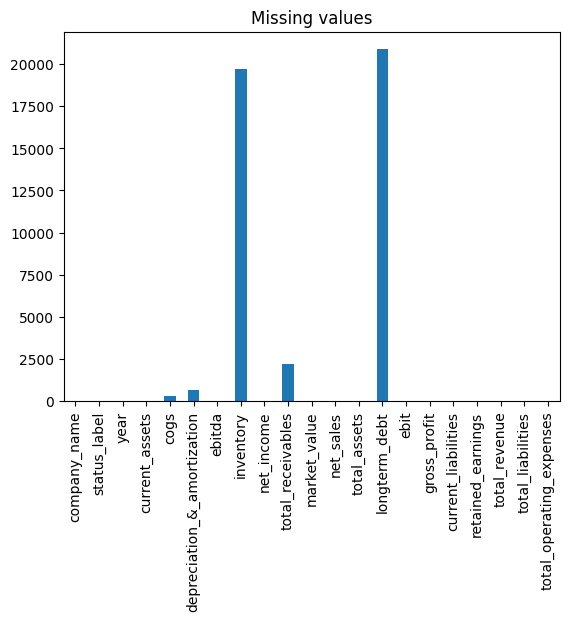

In [10]:
df.isna().sum().plot(kind='bar', title='Missing values')

In [11]:
df.isnull().sum()

company_name                       0
status_label                       0
year                               0
current_assets                     0
cogs                             306
depreciation_&_amortization      633
ebitda                             3
inventory                      19701
net_income                         7
total_receivables               2205
market_value                       0
net_sales                          0
total_assets                       0
longterm_debt                  20884
ebit                               0
gross_profit                      25
current_liabilities                0
retained_earnings                  0
total_revenue                      0
total_liabilities                  0
total_operating_expenses           1
dtype: int64

# Chapter 2: Exploratory data analysis(EDA)/Preprocessing

# Data cleaning

# Treatment of missing values

Dropping the missing values from COGS column

In [12]:
df.dropna(subset=['cogs'], inplace=True)

In [13]:
df.isnull().sum()

company_name                       0
status_label                       0
year                               0
current_assets                     0
cogs                               0
depreciation_&_amortization      530
ebitda                             3
inventory                      19422
net_income                         7
total_receivables               2079
market_value                       0
net_sales                          0
total_assets                       0
longterm_debt                  20686
ebit                               0
gross_profit                      25
current_liabilities                0
retained_earnings                  0
total_revenue                      0
total_liabilities                  0
total_operating_expenses           0
dtype: int64

Calculating medians to fill the missing values

In [14]:
depreciation_and_amortization_median = df['depreciation_&_amortization'].median()
print(depreciation_and_amortization_median)


8.2315


In [15]:
inventory_median= df['inventory'].median()
print(inventory_median)

23.397


In [16]:
total_receivables_median= df['total_receivables'].median()
print(total_receivables_median)

25.409


In [17]:

longterm_debt_median= df['longterm_debt'].median()
print(longterm_debt_median)

58.9395


In [18]:
ebitda_median= df['ebitda'].median()
print(ebitda_median)

15.303


In [19]:
gross_profit_median= df['gross_profit'].median()
print(gross_profit_median)

64.506


In [20]:
net_income_median= df['net_income'].median()
print(net_income_median)

1.656


In [21]:
total_operating_expenses_median= df['total_operating_expenses'].median()
print(total_operating_expenses_median)

171.209


Filling the missing values in each column with the median value

In [22]:
df['depreciation_&_amortization'].fillna(depreciation_and_amortization_median, inplace=True)
df['inventory'].fillna(inventory_median, inplace=True)
df['total_receivables'].fillna(total_receivables_median, inplace=True)
df['longterm_debt'].fillna(longterm_debt_median,inplace=True)
df['ebitda'].fillna(ebitda_median, inplace=True)
df['gross_profit'].fillna(gross_profit_median, inplace=True)
df['net_income'].fillna(net_income_median, inplace=True)
df['total_operating_expenses'].fillna(total_operating_expenses_median, inplace=True)

In [23]:
df.isna().sum()

company_name                   0
status_label                   0
year                           0
current_assets                 0
cogs                           0
depreciation_&_amortization    0
ebitda                         0
inventory                      0
net_income                     0
total_receivables              0
market_value                   0
net_sales                      0
total_assets                   0
longterm_debt                  0
ebit                           0
gross_profit                   0
current_liabilities            0
retained_earnings              0
total_revenue                  0
total_liabilities              0
total_operating_expenses       0
dtype: int64

In [24]:
df.dtypes

company_name                    object
status_label                    object
year                             int64
current_assets                 float64
cogs                            object
depreciation_&_amortization    float64
ebitda                         float64
inventory                      float64
net_income                     float64
total_receivables              float64
market_value                   float64
net_sales                      float64
total_assets                   float64
longterm_debt                  float64
ebit                           float64
gross_profit                   float64
current_liabilities            float64
retained_earnings              float64
total_revenue                  float64
total_liabilities              float64
total_operating_expenses       float64
dtype: object

In [25]:
df['cogs'] = df['cogs'].astype(float)


# Treatment of outliers

# Pre cleaning univariate analysis(Before removing outliers)

In [26]:
print(df.columns)

Index(['company_name', 'status_label', 'year', 'current_assets', 'cogs',
       'depreciation_&_amortization', 'ebitda', 'inventory', 'net_income',
       'total_receivables', 'market_value', 'net_sales', 'total_assets',
       'longterm_debt', 'ebit', 'gross_profit', 'current_liabilities',
       'retained_earnings', 'total_revenue', 'total_liabilities',
       'total_operating_expenses'],
      dtype='object')


<Axes: xlabel='current_assets'>

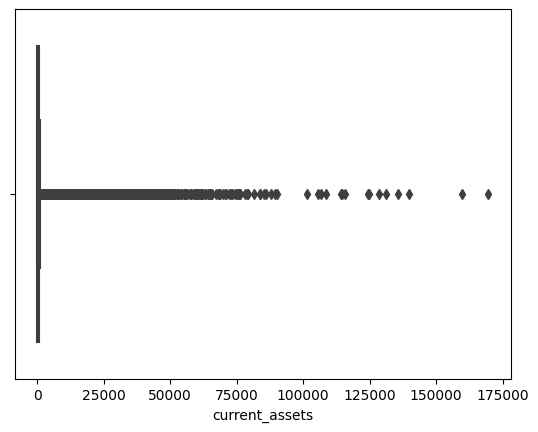

In [27]:
sns.boxplot(df['current_assets'])

<Axes: xlabel='current_assets', ylabel='Density'>

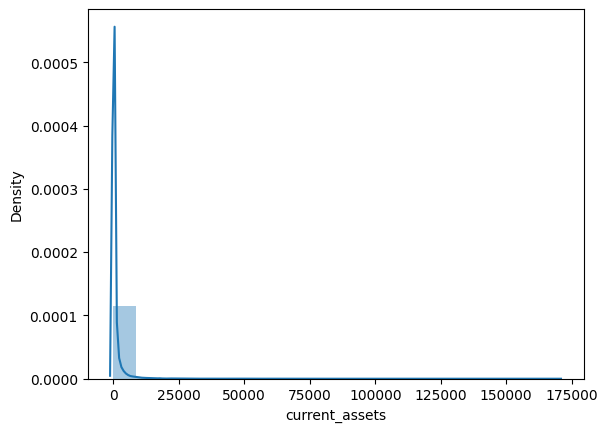

In [28]:
sns.distplot(df['current_assets'],bins=20)

<Axes: xlabel='cogs'>

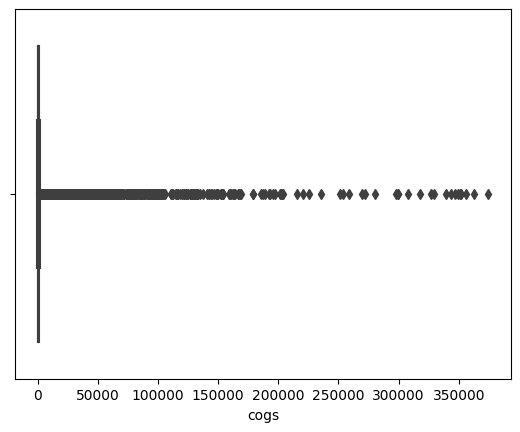

In [29]:
sns.boxplot(df['cogs'])

<Axes: xlabel='cogs', ylabel='Density'>

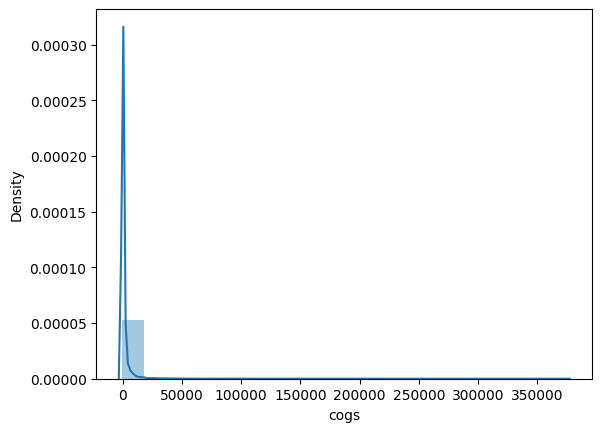

In [30]:
sns.distplot(df['cogs'], bins=20)

<Axes: xlabel='depreciation_&_amortization'>

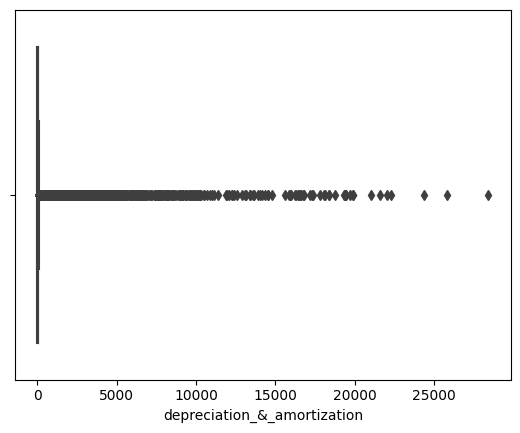

In [32]:
sns.boxplot(df['depreciation_&_amortization'])

<Axes: xlabel='depreciation_&_amortization', ylabel='Density'>

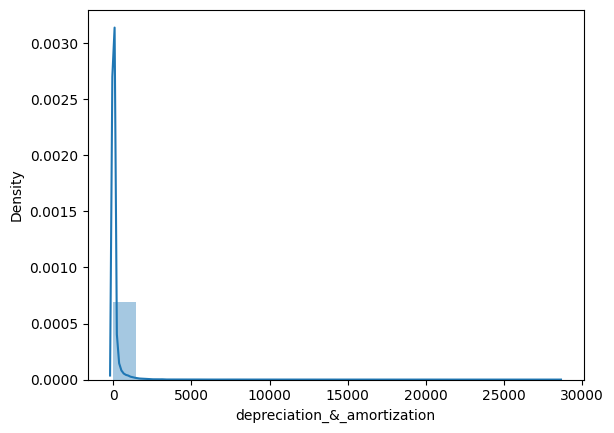

In [33]:
sns.distplot(df['depreciation_&_amortization'], bins=20)

<Axes: xlabel='ebitda'>

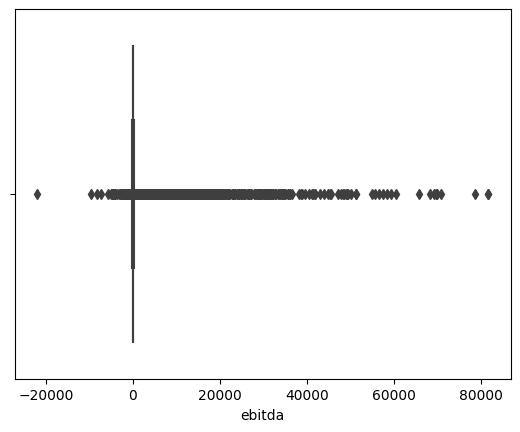

In [34]:
sns.boxplot(df['ebitda'])

<Axes: xlabel='ebitda', ylabel='Density'>

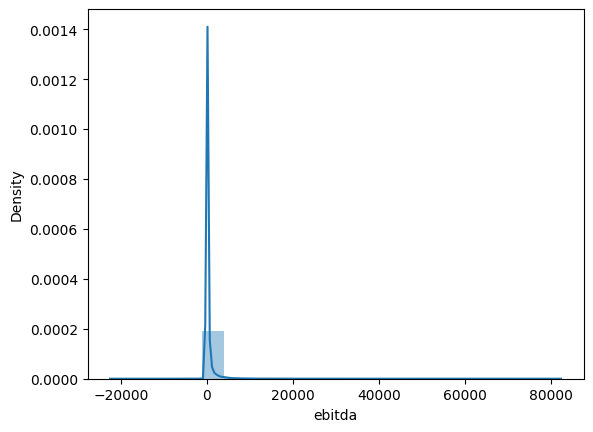

In [35]:
sns.distplot(df['ebitda'], bins=20)

<Axes: xlabel='inventory'>

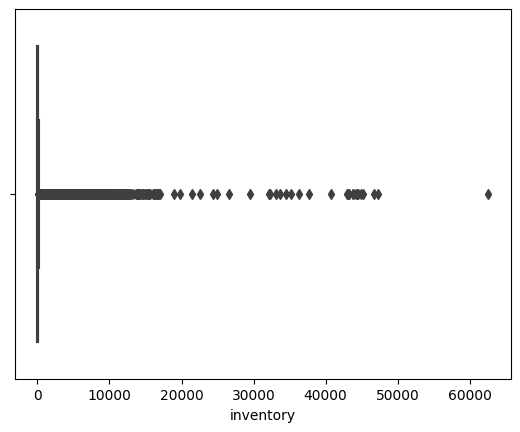

In [36]:
sns.boxplot(df['inventory'])

<Axes: xlabel='inventory', ylabel='Density'>

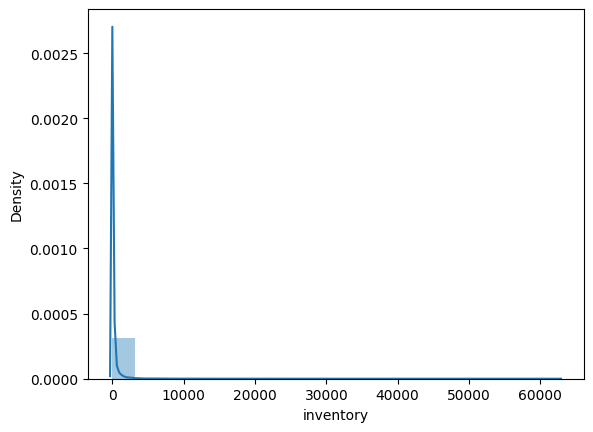

In [37]:
sns.distplot(df['inventory'], bins=20)

<Axes: xlabel='net_income'>

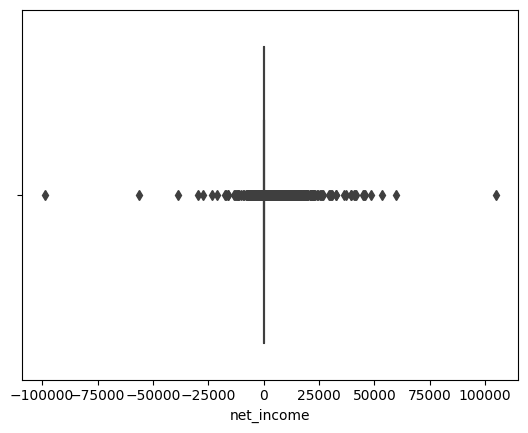

In [38]:
sns.boxplot(df['net_income'])

<Axes: xlabel='net_income', ylabel='Density'>

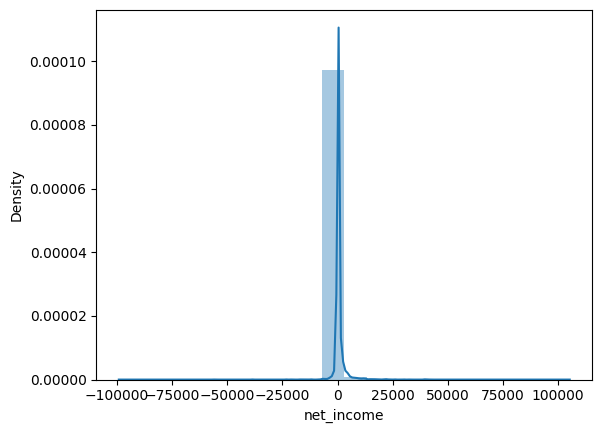

In [39]:
sns.distplot(df['net_income'], bins=20)

<Axes: xlabel='total_receivables'>

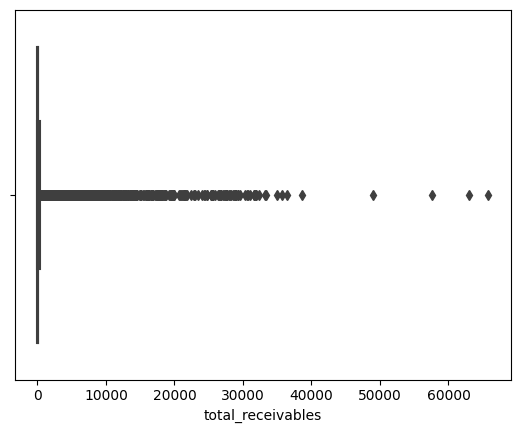

In [40]:
sns.boxplot(df['total_receivables'])

<Axes: xlabel='total_receivables', ylabel='Density'>

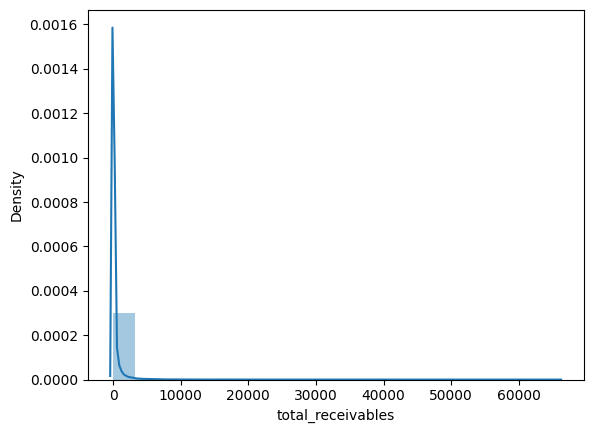

In [41]:
sns.distplot(df['total_receivables'], bins=20)

<Axes: xlabel='market_value'>

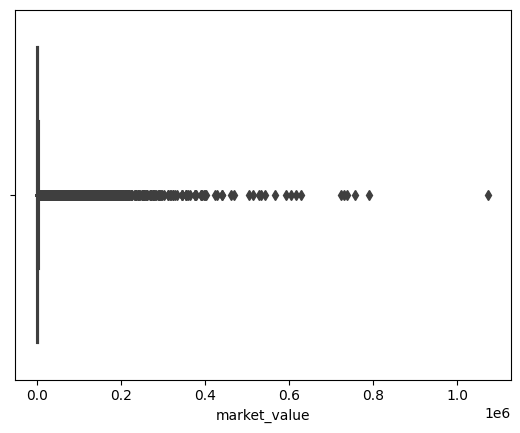

In [42]:
sns.boxplot(df['market_value'])

<Axes: xlabel='market_value', ylabel='Density'>

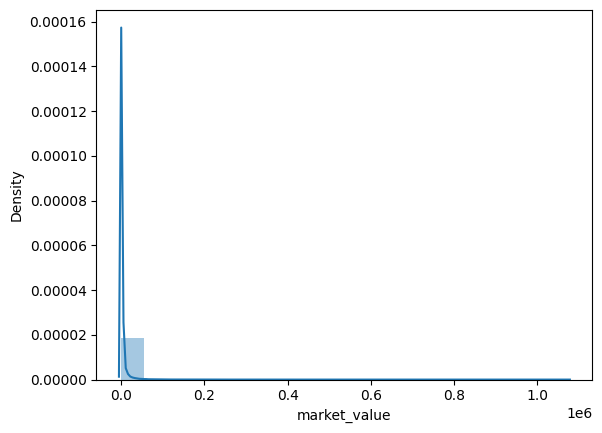

In [43]:
sns.distplot(df['market_value'], bins=20)

<Axes: xlabel='net_sales'>

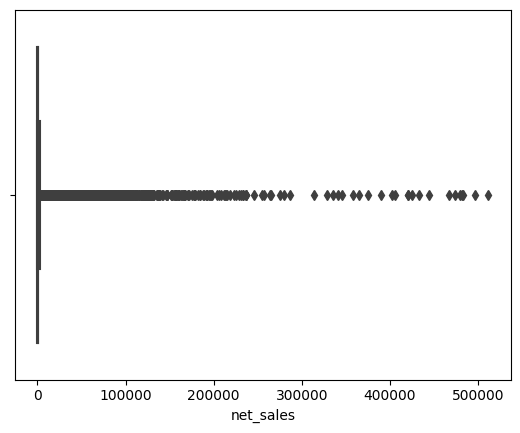

In [44]:
sns.boxplot(df['net_sales'])

<Axes: xlabel='net_sales', ylabel='Density'>

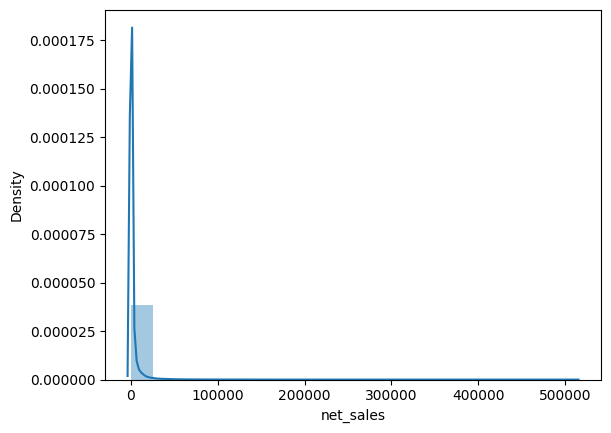

In [45]:
sns.distplot(df['net_sales'], bins=20)

<Axes: xlabel='total_assets'>

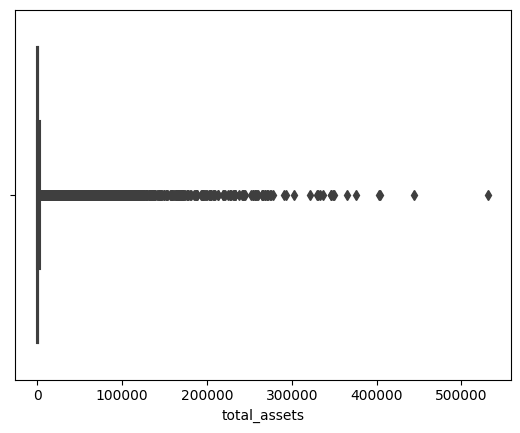

In [46]:
sns.boxplot(df['total_assets'])

<Axes: xlabel='total_assets', ylabel='Density'>

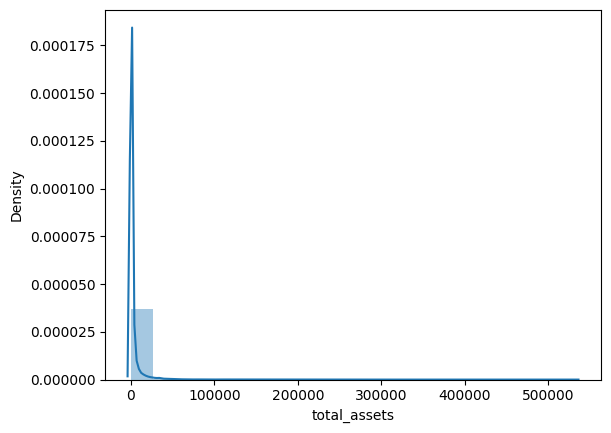

In [47]:
sns.distplot(df['total_assets'], bins=20)

<Axes: xlabel='longterm_debt'>

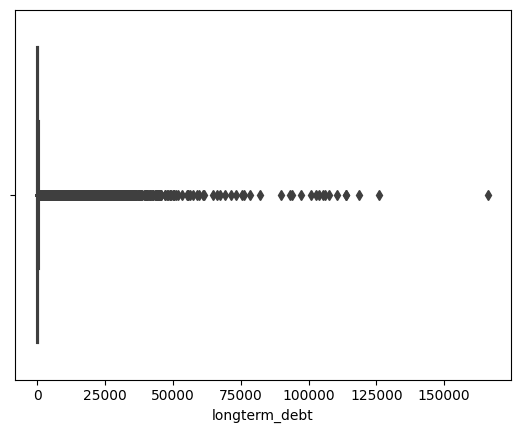

In [48]:
sns.boxplot(df['longterm_debt'])

<Axes: xlabel='longterm_debt', ylabel='Density'>

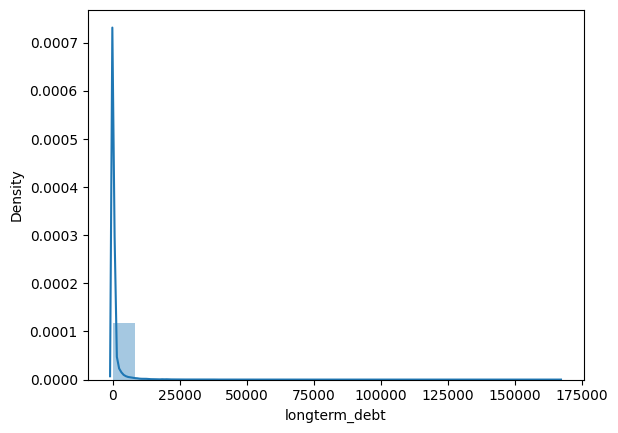

In [49]:
sns.distplot(df['longterm_debt'], bins=20)

<Axes: xlabel='ebit'>

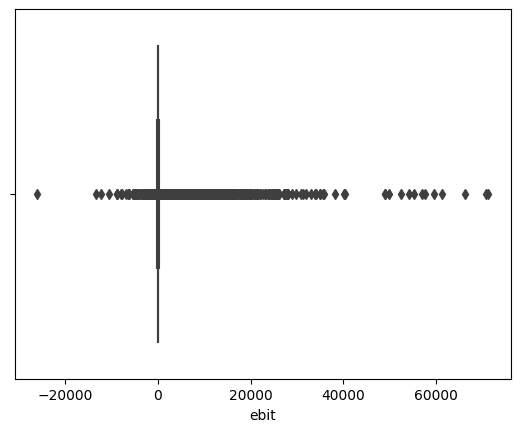

In [50]:
sns.boxplot(df['ebit'])

<Axes: xlabel='ebit', ylabel='Density'>

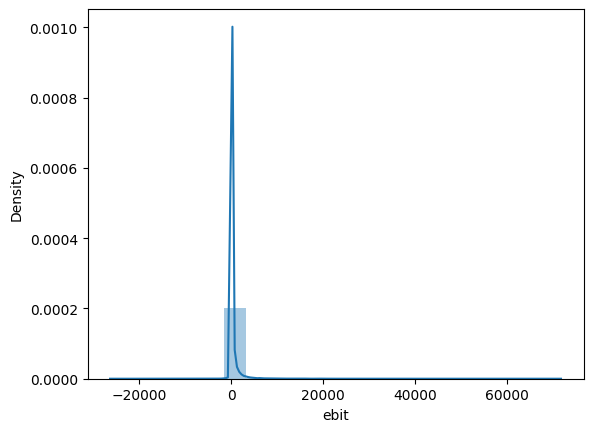

In [51]:
sns.distplot(df['ebit'], bins=20)

<Axes: xlabel='gross_profit'>

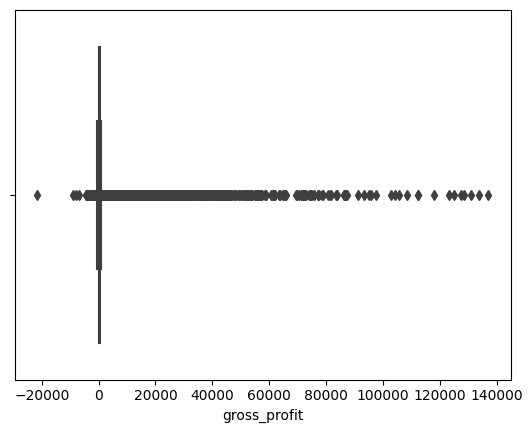

In [52]:
sns.boxplot(df['gross_profit'])

<Axes: xlabel='gross_profit', ylabel='Density'>

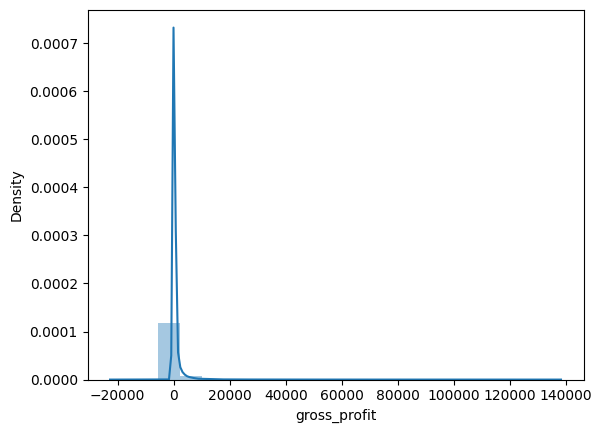

In [53]:
sns.distplot(df['gross_profit'], bins=20)

<Axes: xlabel='current_liabilities'>

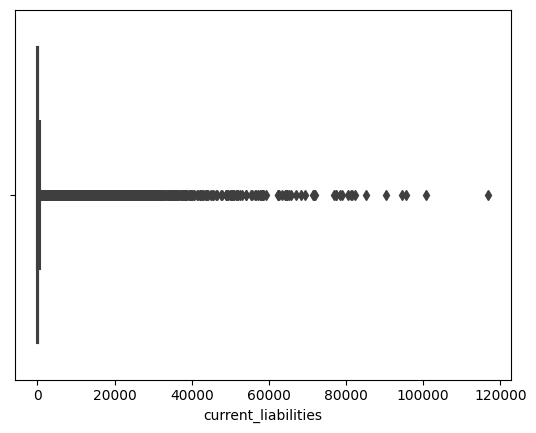

In [54]:
sns.boxplot(df['current_liabilities'])

<Axes: xlabel='current_liabilities', ylabel='Density'>

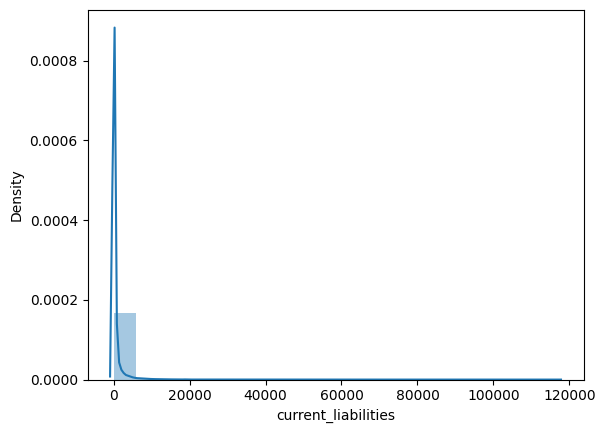

In [55]:
sns.distplot(df['current_liabilities'], bins=20)

<Axes: xlabel='retained_earnings'>

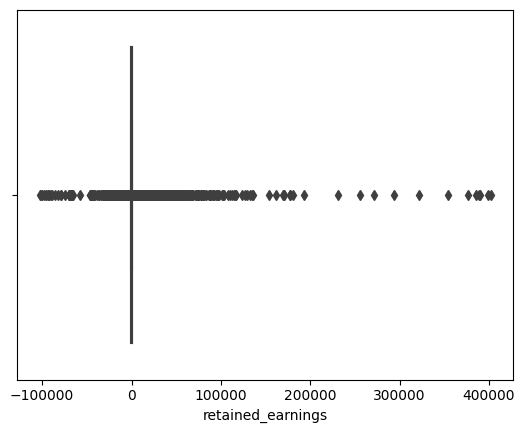

In [56]:
sns.boxplot(df['retained_earnings'])

<Axes: xlabel='retained_earnings', ylabel='Density'>

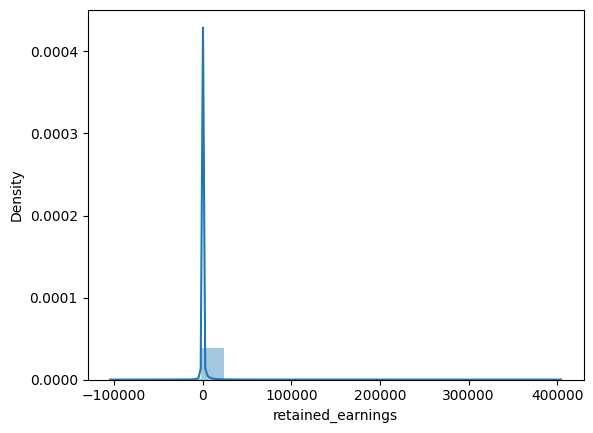

In [57]:
sns.distplot(df['retained_earnings'], bins=20)

<Axes: xlabel='total_revenue'>

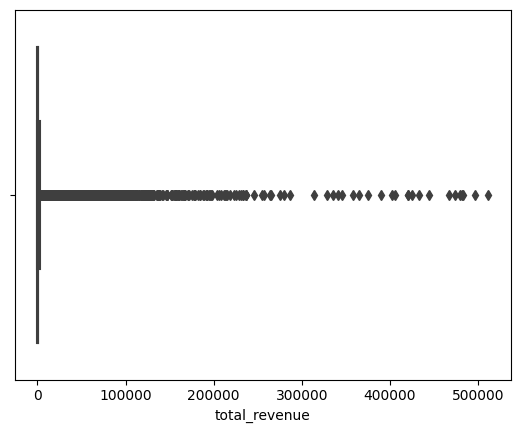

In [58]:
sns.boxplot(df['total_revenue'])

<Axes: xlabel='total_revenue', ylabel='Density'>

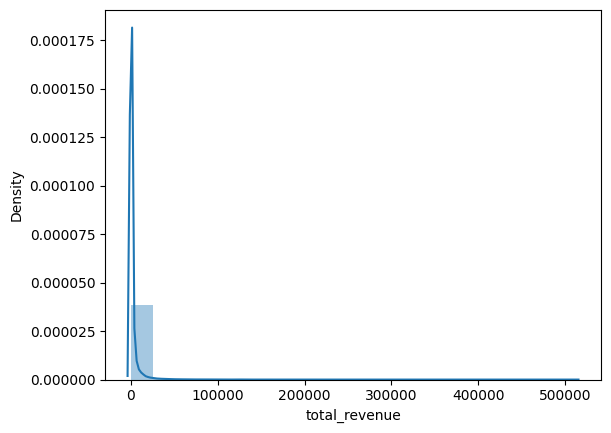

In [59]:
sns.distplot(df['total_revenue'], bins=20)

<Axes: xlabel='total_liabilities'>

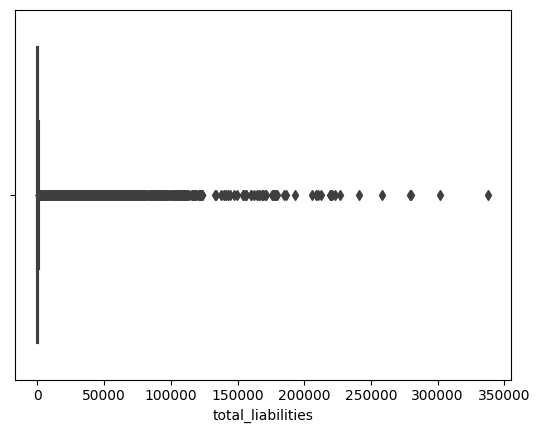

In [60]:
sns.boxplot(df['total_liabilities'])

<Axes: xlabel='total_liabilities', ylabel='Density'>

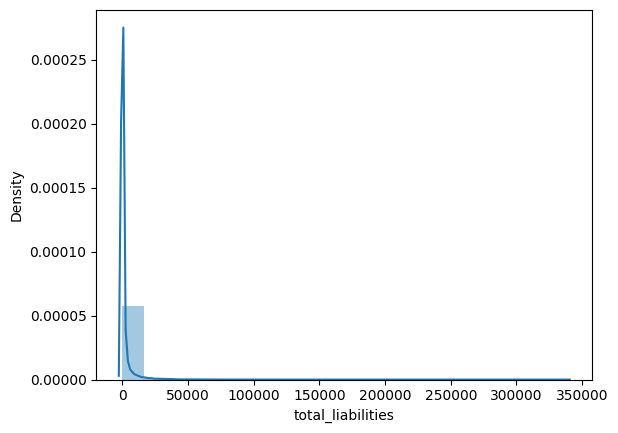

In [61]:
sns.distplot(df['total_liabilities'], bins=20)

<Axes: xlabel='total_operating_expenses'>

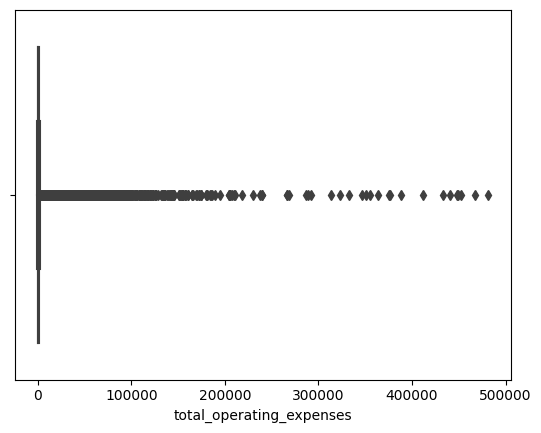

In [62]:
sns.boxplot(df['total_operating_expenses'])

<Axes: xlabel='total_operating_expenses', ylabel='Density'>

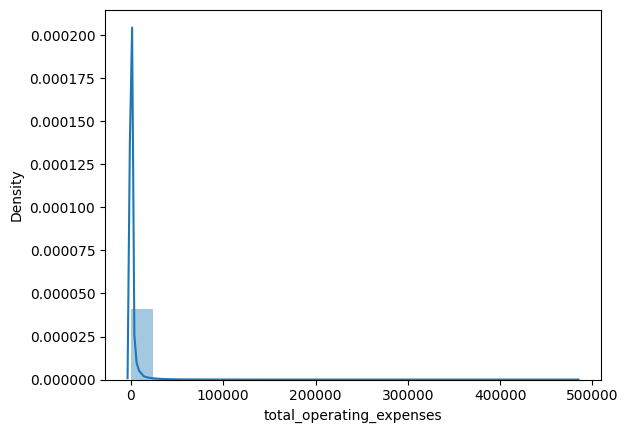

In [63]:
sns.distplot(df['total_operating_expenses'], bins=20)

# Removing outliers by Percentile method

In [26]:
percentiles = {
    'current_assets': (0.05, 0.55),
    'cogs': (0.05, 0.65),
    'depreciation_&_amortization': (0.05, 0.55),
    'ebitda': (0.15, 0.65),
    'inventory': (0.05, 0.75),
    'net_income': (0.25, 0.65),
    'total_receivables': (0.05, 0.65),
    'market_value': (0.05, 0.65),
    'net_sales': (0.05, 0.65),
    'total_assets': (0.05, 0.55),
    'longterm_debt': (0.05, 0.85),
    'ebit': (0.25, 0.65),
    'gross_profit': (0.05, 0.65),
    'current_liabilities': (0.05, 0.65),
    'retained_earnings': (0.25, 0.65),
    'total_revenue': (0.05, 0.65),
    'total_liabilities': (0.05, 0.55),
    'total_operating_expenses': (0.05, 0.65)
}

In [27]:
df1 = df.copy()

In [28]:
for column, (lower_threshold, upper_threshold) in percentiles.items():
    lower_bound = df[column].quantile(lower_threshold)
    upper_bound = df[column].quantile(upper_threshold)
    df1 = df1[(df1[column] >= lower_bound) & (df1[column] <= upper_bound)]

In [29]:
df1.reset_index(drop=True, inplace=True)

In [30]:
df.shape

(78376, 21)

In [31]:
df1.shape

(10046, 21)

In [70]:
df1.head(30)

,company_name,status_label,year,current_assets,cogs,depreciation_&_amortization,ebitda,inventory,net_income,total_receivables,...,net_sales,total_assets,longterm_debt,ebit,gross_profit,current_liabilities,retained_earnings,total_revenue,total_liabilities,total_operating_expenses
0,C_3,alive,2000,7.884,16.506,0.700,0.672,4.078,-0.808,3.244,...,25.367,11.608,4.8750,-0.028,8.861,2.278,-7.184,25.367,7.153,24.695
1,C_3,alive,2004,5.807,12.018,0.160,1.614,2.704,1.345,2.504,...,19.833,6.245,0.2220,1.454,7.815,3.222,-8.974,19.833,3.580,18.219
2,C_3,alive,2005,7.726,14.013,0.177,1.856,3.921,1.900,2.704,...,23.135,8.153,58.9395,1.679,9.122,3.375,-7.073,23.135,3.490,21.279
3,C_3,alive,2006,13.582,15.454,0.216,1.252,4.835,1.005,2.757,...,24.998,14.341,58.9395,1.036,9.544,3.600,-5.977,24.998,3.672,23.746
4,C_3,alive,2007,13.454,17.589,0.500,-0.432,6.395,-4.673,5.031,...,28.720,27.171,5.8220,-0.932,11.131,6.259,-10.708,28.720,12.296,29.152
5,C_5,alive,1999,28.957,79.567,2.024,3.873,10.947,-0.138,15.890,...,107.310,42.210,0.5910,1.849,27.743,39.835,-33.199,107.310,52.453,103.437
6,C_7,alive,1999,27.276,15.475,0.729,1.171,5.125,-0.366,17.204,...,23.862,51.073,28.2900,0.442,8.387,12.934,-2.683,23.862,41.937,22.691
7,C_7,alive,2000,28.391,71.924,1.951,3.960,7.472,-0.690,17.373,...,89.817,55.896,26.1010,2.009,17.893,16.759,-3.984,89.817,48.828,85.857
8,C_7,alive,2001,26.587,71.406,2.076,6.381,7.729,-0.264,17.000,...,90.994,53.030,18.5880,4.305,19.588,18.524,-4.901,90.994,43.209,84.613
9,C_7,alive,2002,21.724,63.520,1.254,3.455,7.342,-0.123,12.037,...,78.877,46.677,16.2020,2.201,15.357,15.447,-5.202,78.877,37.266,75.422


# Post cleaning univariate analysis

<Axes: xlabel='current_assets'>

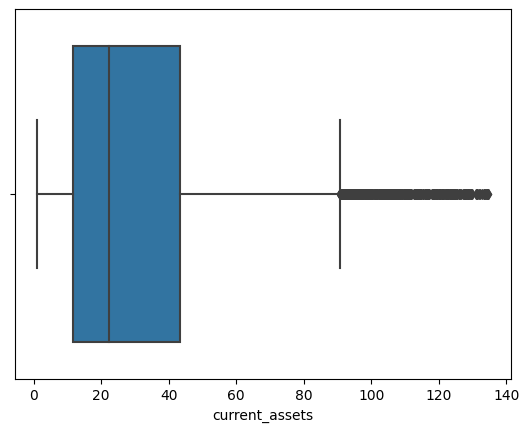

In [72]:
sns.boxplot(df1['current_assets'])

<Axes: xlabel='current_assets', ylabel='Density'>

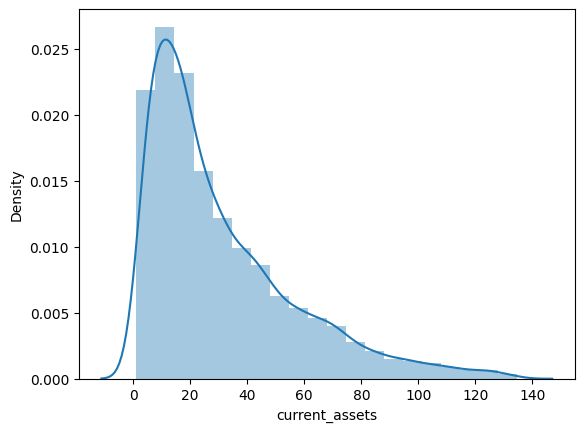

In [502]:
sns.distplot(df1['current_assets'],bins=20)

<Axes: xlabel='cogs'>

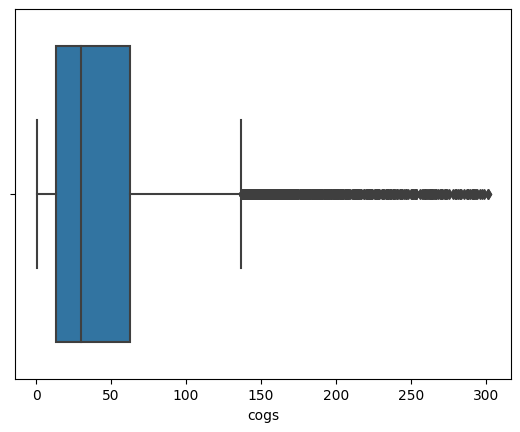

In [503]:
sns.boxplot(df1['cogs'])

<Axes: xlabel='cogs', ylabel='Density'>

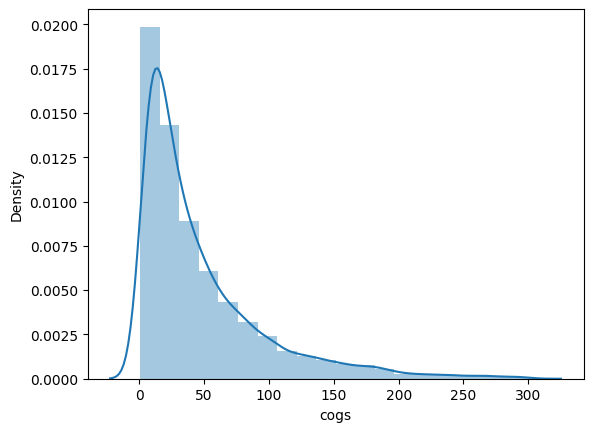

In [504]:
sns.distplot(df1['cogs'], bins=20)

<Axes: xlabel='depreciation_&_amortization'>

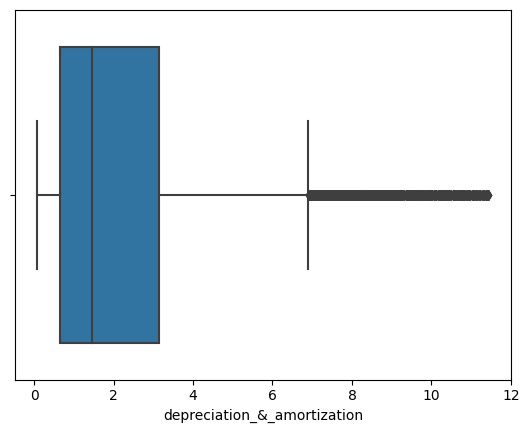

In [505]:
sns.boxplot(df1['depreciation_&_amortization'])

<Axes: xlabel='depreciation_&_amortization', ylabel='Density'>

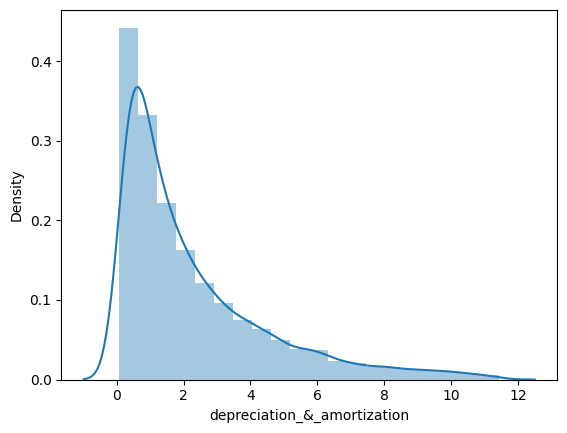

In [506]:
sns.distplot(df1['depreciation_&_amortization'], bins=20)

<Axes: xlabel='ebitda'>

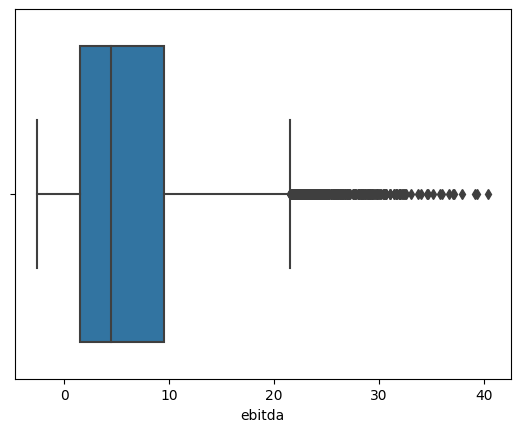

In [507]:
sns.boxplot(df1['ebitda'])

<Axes: xlabel='gross_profit', ylabel='Density'>

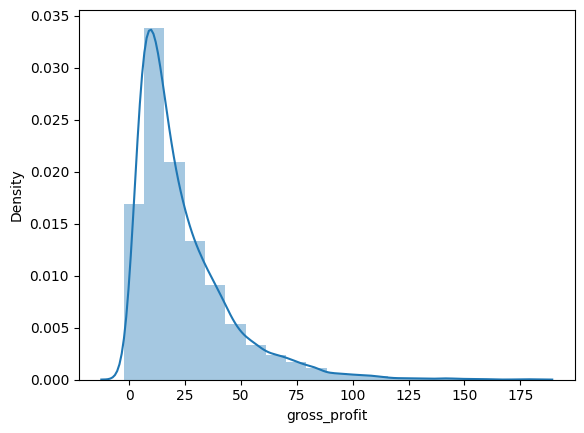

In [508]:
sns.distplot(df1['gross_profit'], bins=20)

<Axes: xlabel='inventory'>

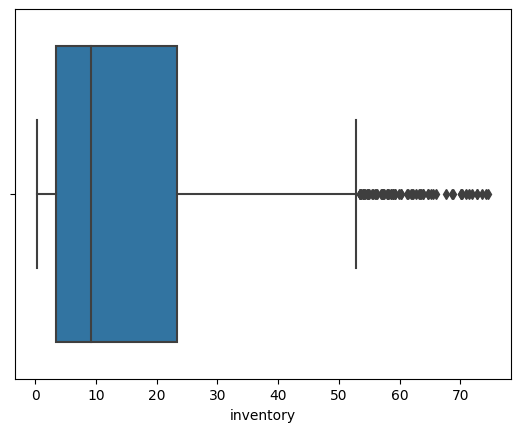

In [509]:
sns.boxplot(df1['inventory'])

<Axes: xlabel='inventory', ylabel='Density'>

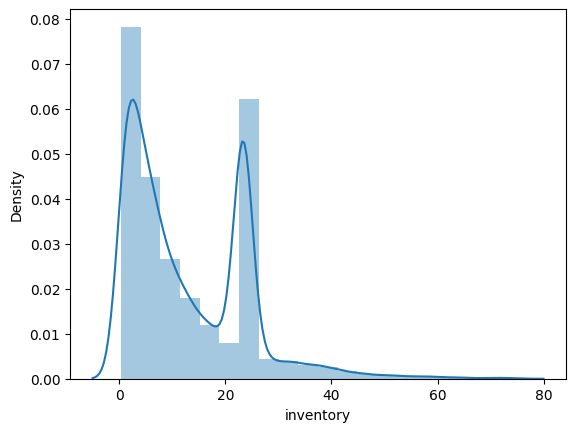

In [510]:
sns.distplot(df1['inventory'], bins=20)

<Axes: xlabel='net_income'>

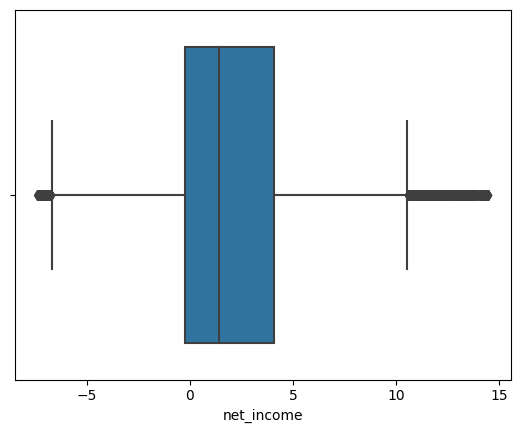

In [511]:
sns.boxplot(df1['net_income'])

<Axes: xlabel='net_income', ylabel='Density'>

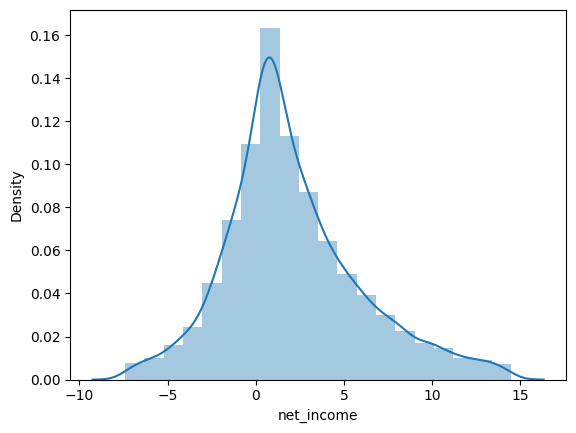

In [512]:
sns.distplot(df1['net_income'], bins=20)

<Axes: xlabel='total_receivables'>

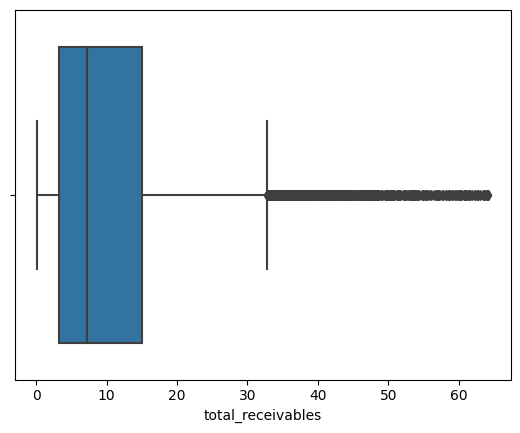

In [513]:
sns.boxplot(df1['total_receivables'])

<Axes: xlabel='total_receivables', ylabel='Density'>

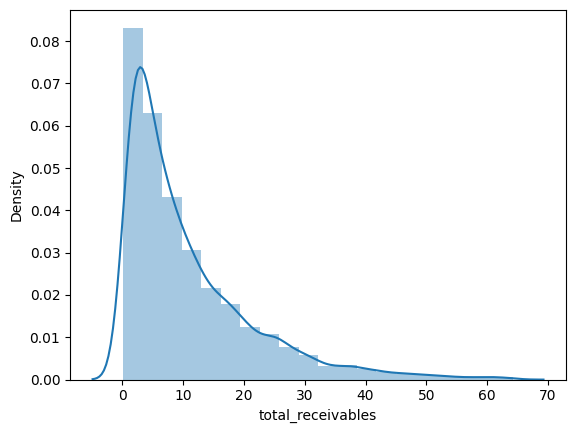

In [514]:
sns.distplot(df1['total_receivables'], bins=20)

<Axes: xlabel='market_value'>

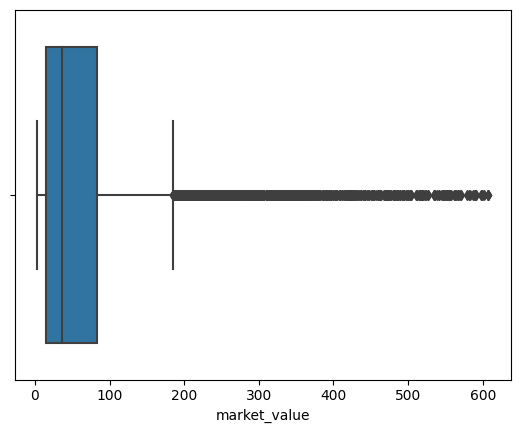

In [515]:
sns.boxplot(df1['market_value'])

<Axes: xlabel='market_value', ylabel='Density'>

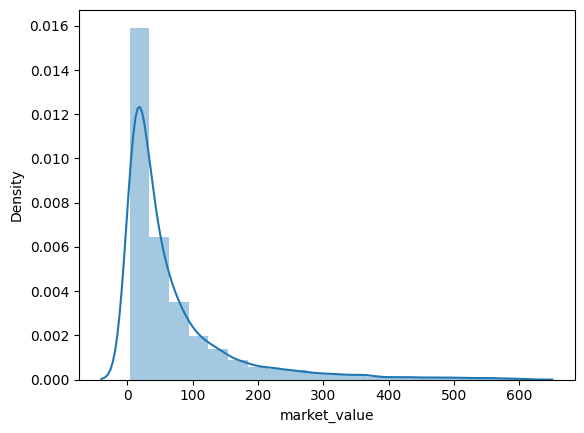

In [516]:
sns.distplot(df1['market_value'], bins=20)

<Axes: xlabel='net_sales'>

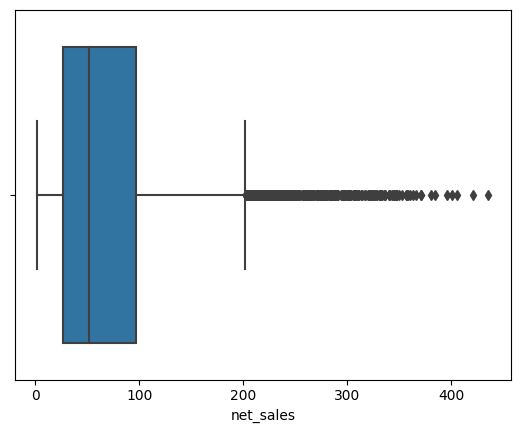

In [517]:
sns.boxplot(df1['net_sales'])

<Axes: xlabel='net_sales', ylabel='Density'>

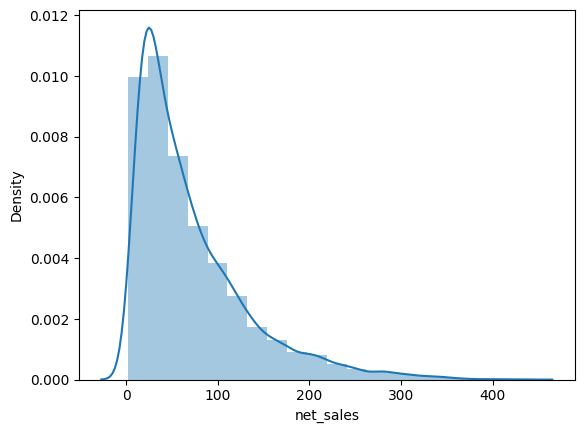

In [518]:
sns.distplot(df1['net_sales'], bins=20)

<Axes: xlabel='total_assets'>

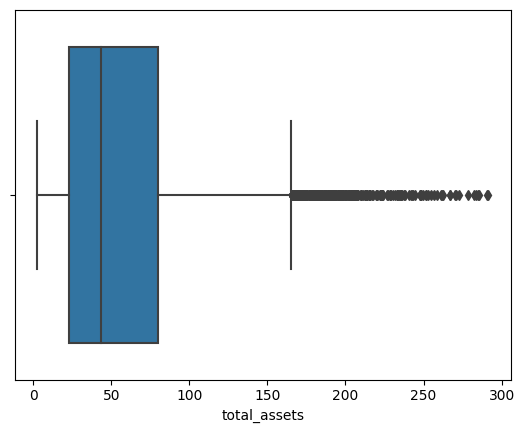

In [519]:
sns.boxplot(df1['total_assets'])

<Axes: xlabel='total_assets', ylabel='Density'>

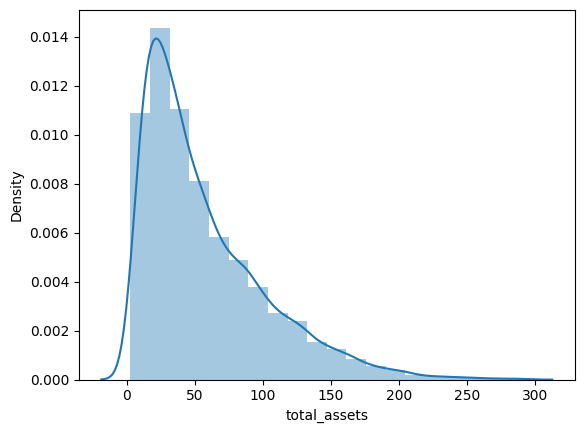

In [520]:
sns.distplot(df1['total_assets'], bins=20)

<Axes: xlabel='longterm_debt'>

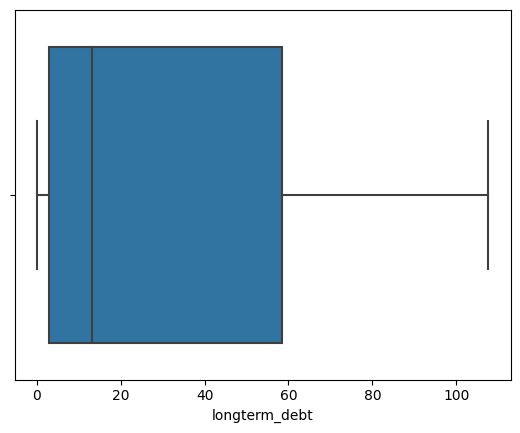

In [521]:
sns.boxplot(df1['longterm_debt'])

<Axes: xlabel='longterm_debt', ylabel='Density'>

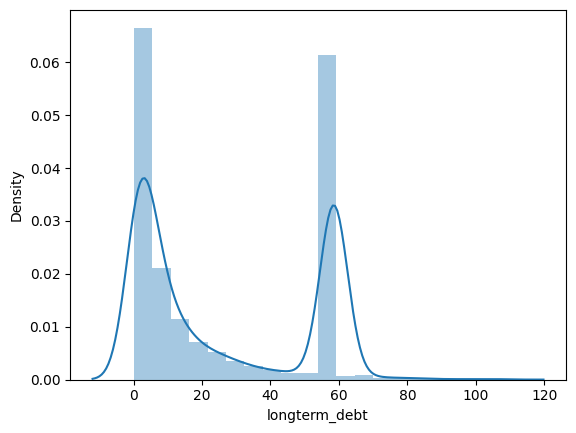

In [522]:
sns.distplot(df1['longterm_debt'], bins=20)

<Axes: xlabel='ebit'>

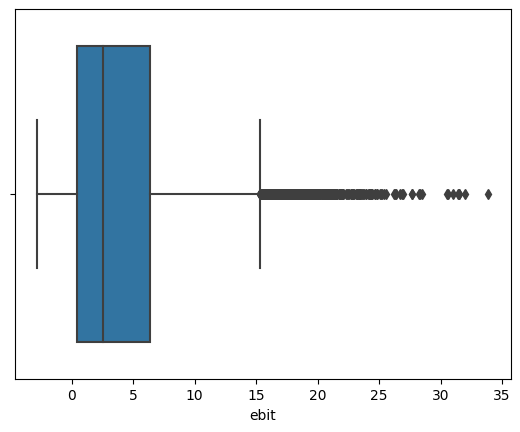

In [523]:
sns.boxplot(df1['ebit'])

<Axes: xlabel='ebit', ylabel='Density'>

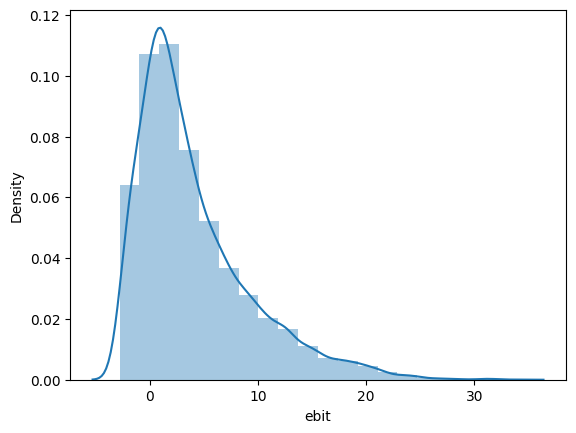

In [524]:
sns.distplot(df1['ebit'], bins=20)

<Axes: xlabel='gross_profit'>

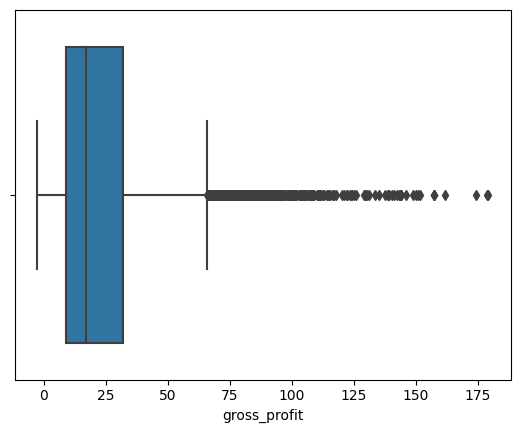

In [525]:
sns.boxplot(df1['gross_profit'])

<Axes: xlabel='gross_profit', ylabel='Density'>

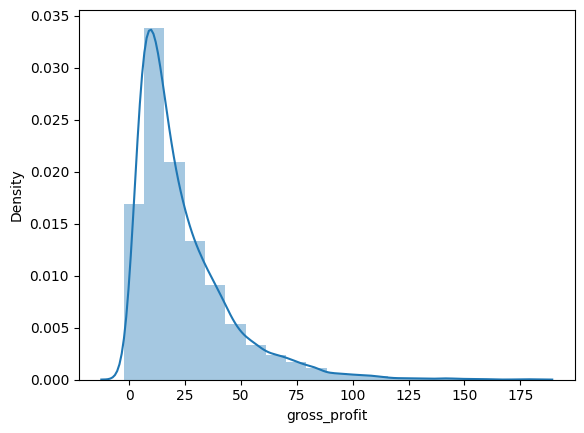

In [526]:
sns.distplot(df1['gross_profit'], bins=20)

<Axes: xlabel='current_liabilities'>

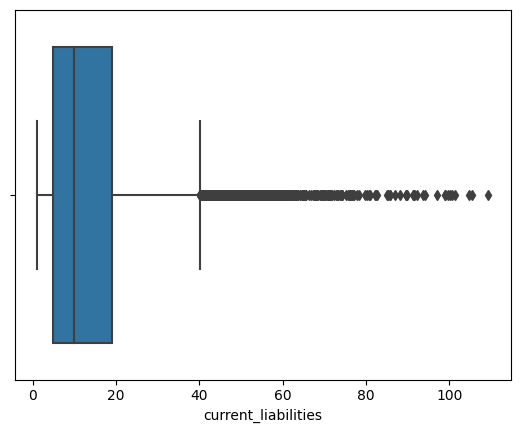

In [527]:
sns.boxplot(df1['current_liabilities'])

<Axes: xlabel='current_liabilities', ylabel='Density'>

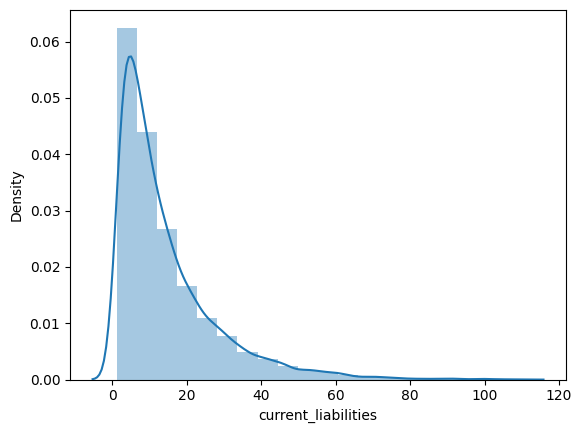

In [528]:
sns.distplot(df1['current_liabilities'], bins=20)

<Axes: xlabel='retained_earnings'>

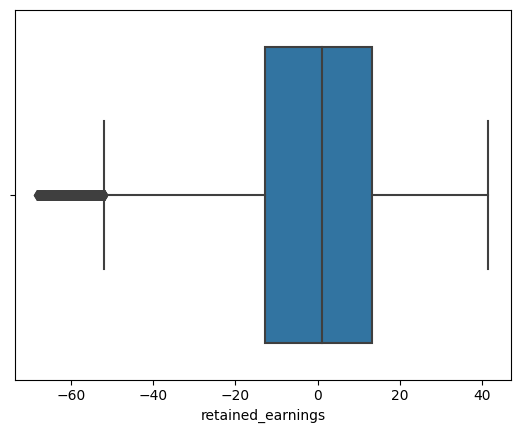

In [529]:
sns.boxplot(df1['retained_earnings'])

<Axes: xlabel='retained_earnings', ylabel='Density'>

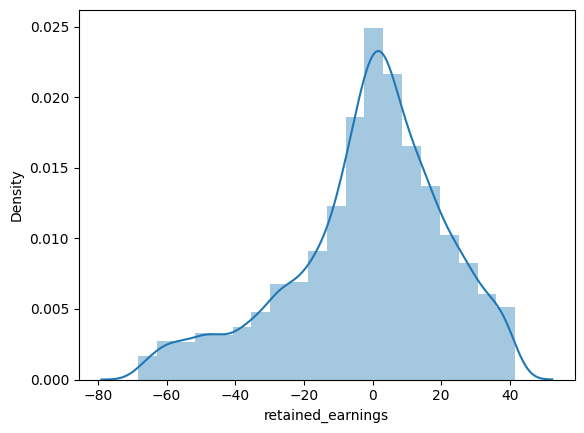

In [530]:
sns.distplot(df1['retained_earnings'], bins=20)

<Axes: xlabel='total_revenue'>

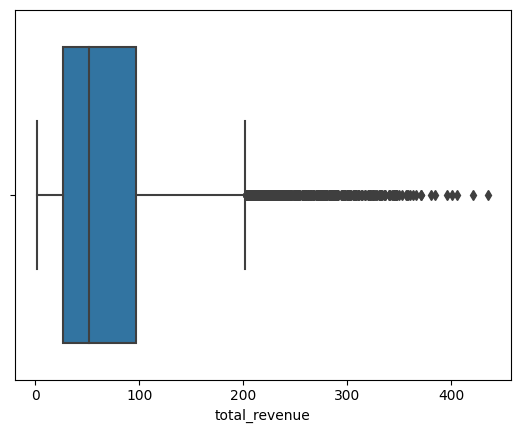

In [531]:
sns.boxplot(df1['total_revenue'])

<Axes: xlabel='total_revenue', ylabel='Density'>

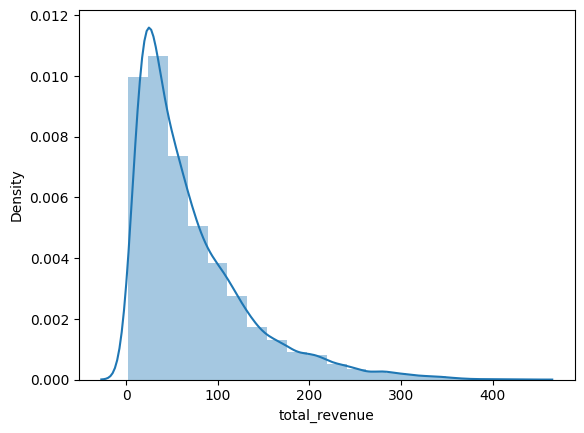

In [532]:
sns.distplot(df1['total_revenue'], bins=20)

<Axes: xlabel='total_liabilities'>

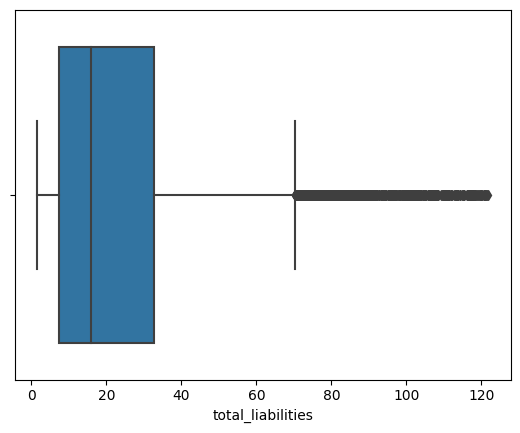

In [533]:
sns.boxplot(df1['total_liabilities'])

<Axes: xlabel='total_liabilities', ylabel='Density'>

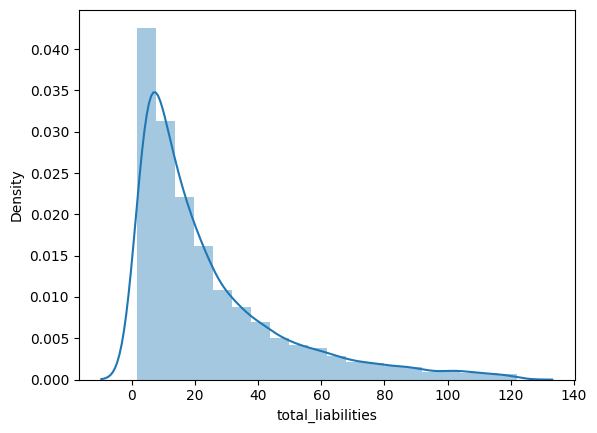

In [534]:
sns.distplot(df1['total_liabilities'], bins=20)

<Axes: xlabel='total_operating_expenses'>

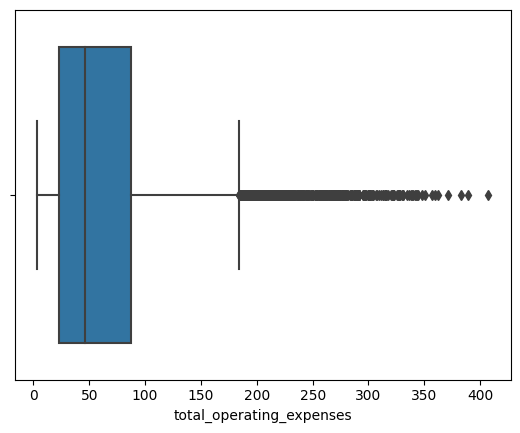

In [535]:
sns.boxplot(df1['total_operating_expenses'])

<Axes: xlabel='total_operating_expenses', ylabel='Density'>

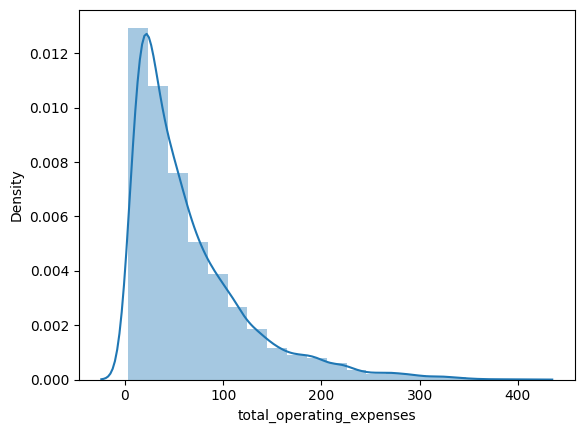

In [536]:
sns.distplot(df1['total_operating_expenses'], bins=20)

# Bivariate and multivariate analysis

# Relationship between cogs and bankruptcy

Text(0.5, 1.0, 'Violin plot of cogs and bankruptcy')

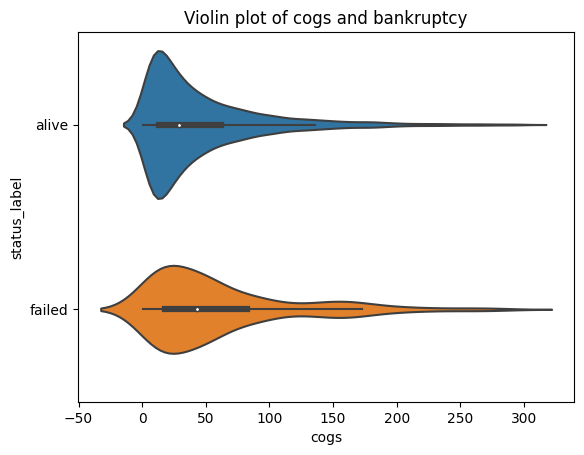

In [31]:
sns.violinplot(data=df1, x= 'cogs', y='status_label')
plt.title('Violin plot of cogs and bankruptcy')

# Relationship between cogs and bankruptcy layered by year

Text(0.5, 1.0, 'Box plot of cogs and bankruptcy layered by year')

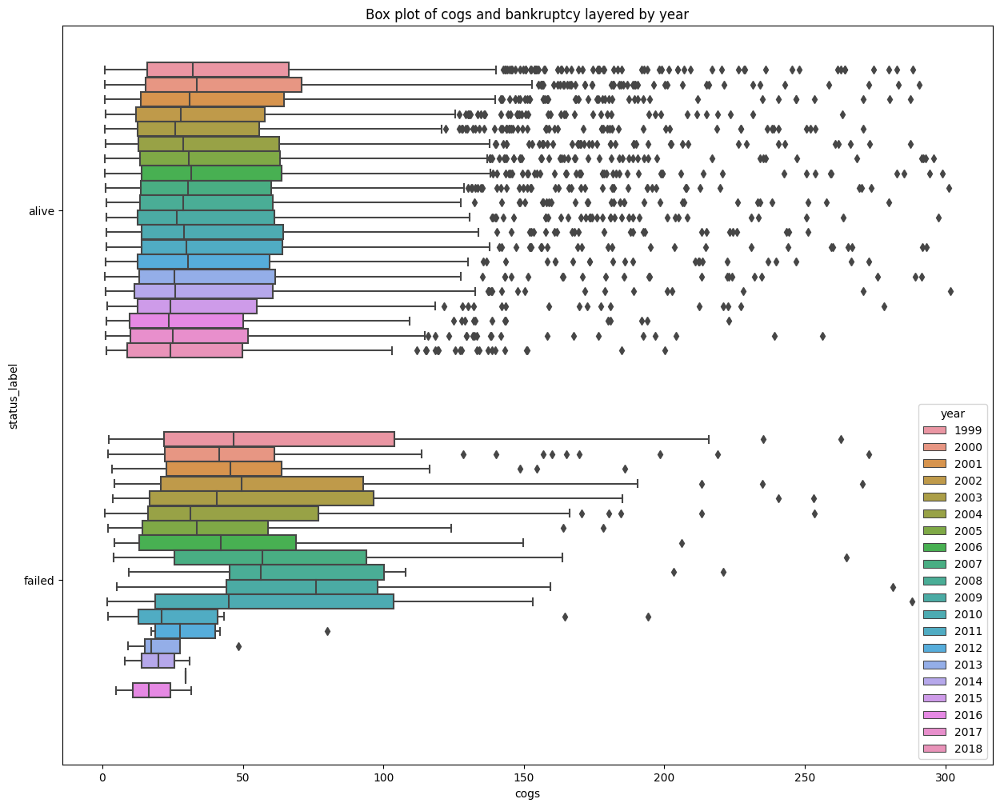

In [32]:
plt.figure(figsize=(15,12))
sns.boxplot(data=df1, x= 'cogs', y='status_label',hue='year')
plt.title('Box plot of cogs and bankruptcy layered by year')

# Relationship between current liabilites and Bankruptcy

Text(0.5, 1.0, 'Violin plot of current liabilities and bankruptcy')

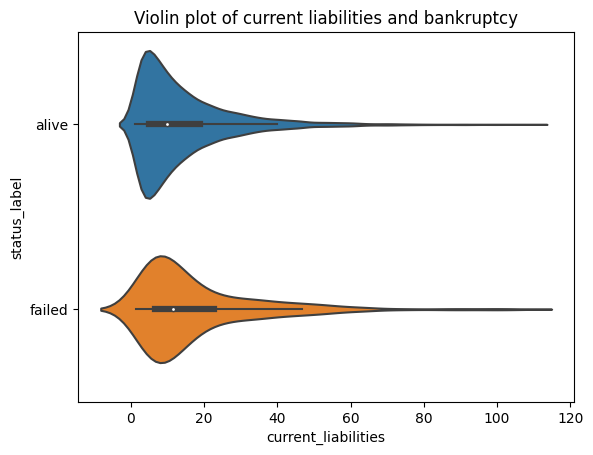

In [33]:
sns.violinplot(data=df1, x= 'current_liabilities', y='status_label')
plt.title('Violin plot of current liabilities and bankruptcy')

Text(0.5, 1.0, 'Box plot of current liabilities and bankruptcies')

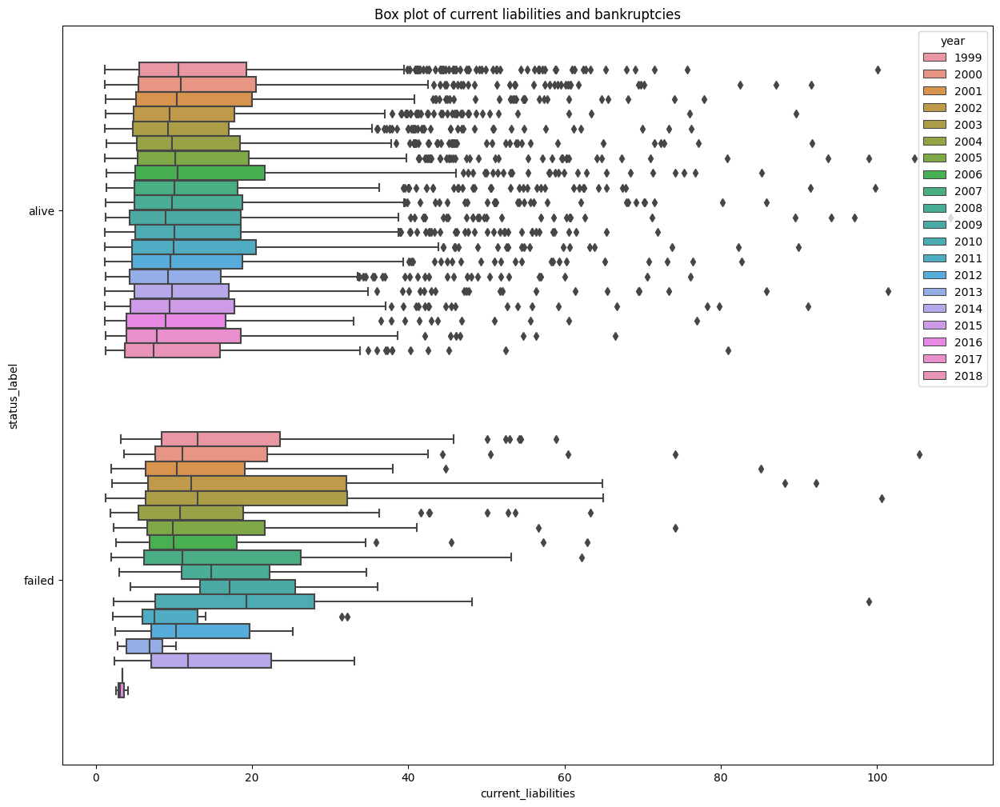

In [36]:
plt.figure(figsize=(15,12))
sns.boxplot(data=df1, x= 'current_liabilities', y='status_label',hue='year')
plt.title('Box plot of current liabilities and bankruptcies')

# Relationship between total liabilites and Bankruptcy

Text(0.5, 1.0, 'Violin plot of total liabilities and bankruptcy')

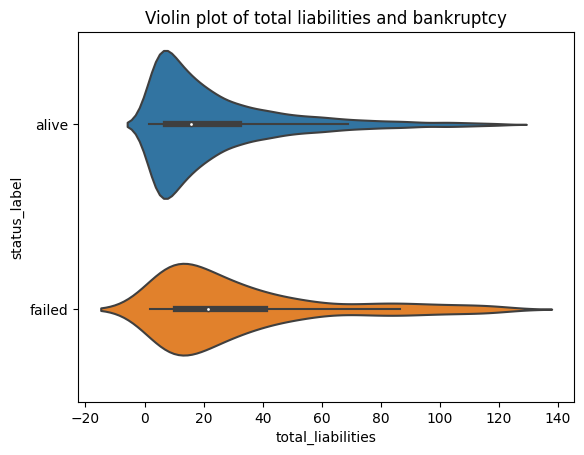

In [35]:
sns.violinplot(data=df1, x= 'total_liabilities', y='status_label')
plt.title('Violin plot of total liabilities and bankruptcy')

Text(0.5, 1.0, 'Box plot of total liabilities and bankruptcy layered by year')

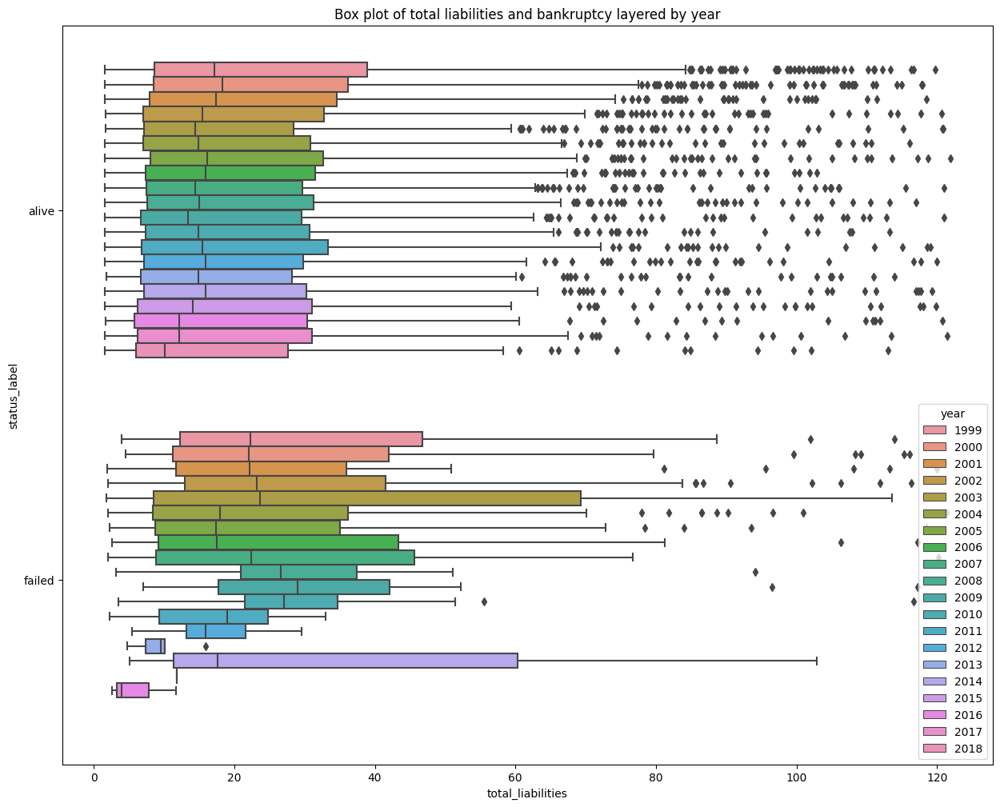

In [37]:
plt.figure(figsize=(15,12))
sns.boxplot(data=df1, x= 'total_liabilities', y='status_label',hue='year')
plt.title('Box plot of total liabilities and bankruptcy layered by year')

# Relationship between Total revenue and bankruptcy

Text(0.5, 1.0, 'Violin plot of total revenue and bankruptcy')

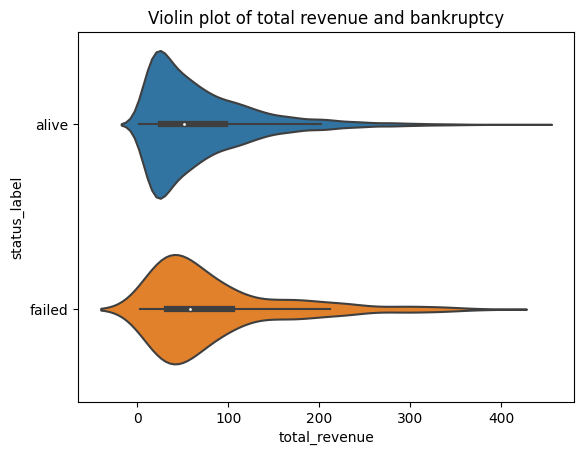

In [38]:
sns.violinplot(data=df1, x= 'total_revenue', y='status_label')
plt.title('Violin plot of total revenue and bankruptcy')

Text(0.5, 1.0, 'Box plot of total revenue and bankruptcy layered by year')

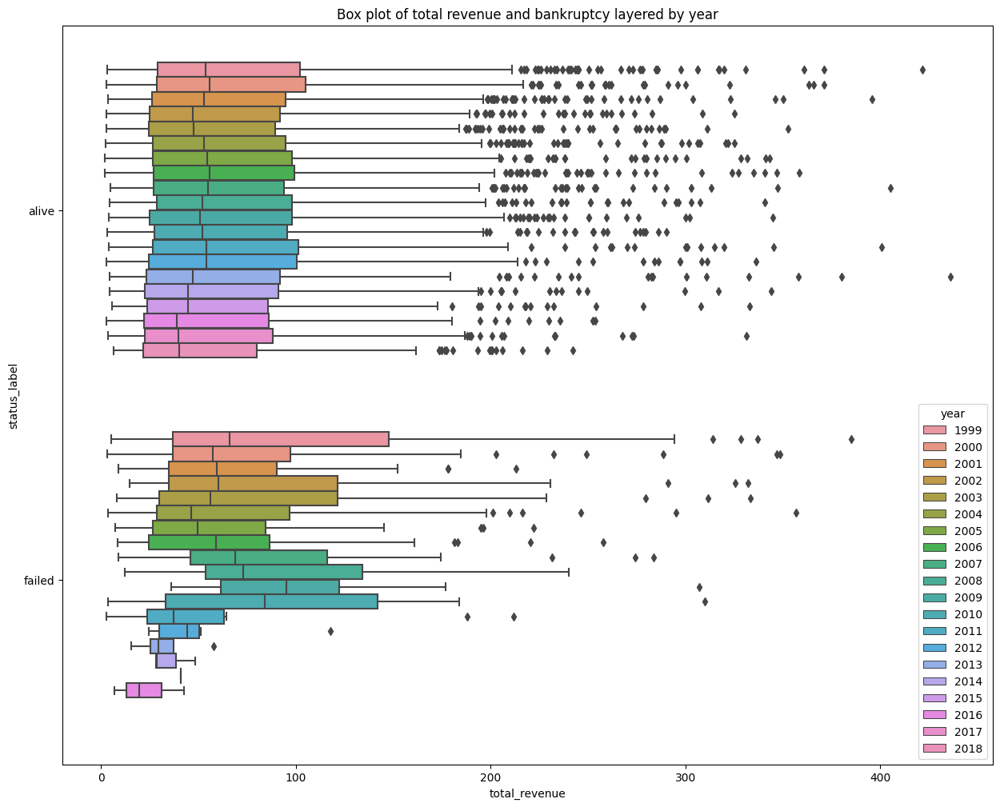

In [39]:
plt.figure(figsize=(15,12))
sns.boxplot(data=df1, x= 'total_revenue', y='status_label',hue='year')
plt.title('Box plot of total revenue and bankruptcy layered by year')

# Relationship between Total operating expenses and bankruptcy

Text(0.5, 1.0, 'Violin plot of total operating expenses and bankruptcy')

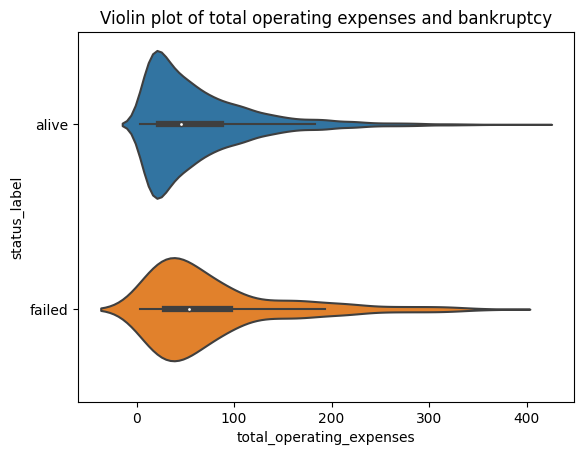

In [40]:
sns.violinplot(data=df1, x= 'total_operating_expenses', y='status_label')
plt.title('Violin plot of total operating expenses and bankruptcy')

Text(0.5, 1.0, 'Box plot of total operating expenses and bankruptcy layered by year')

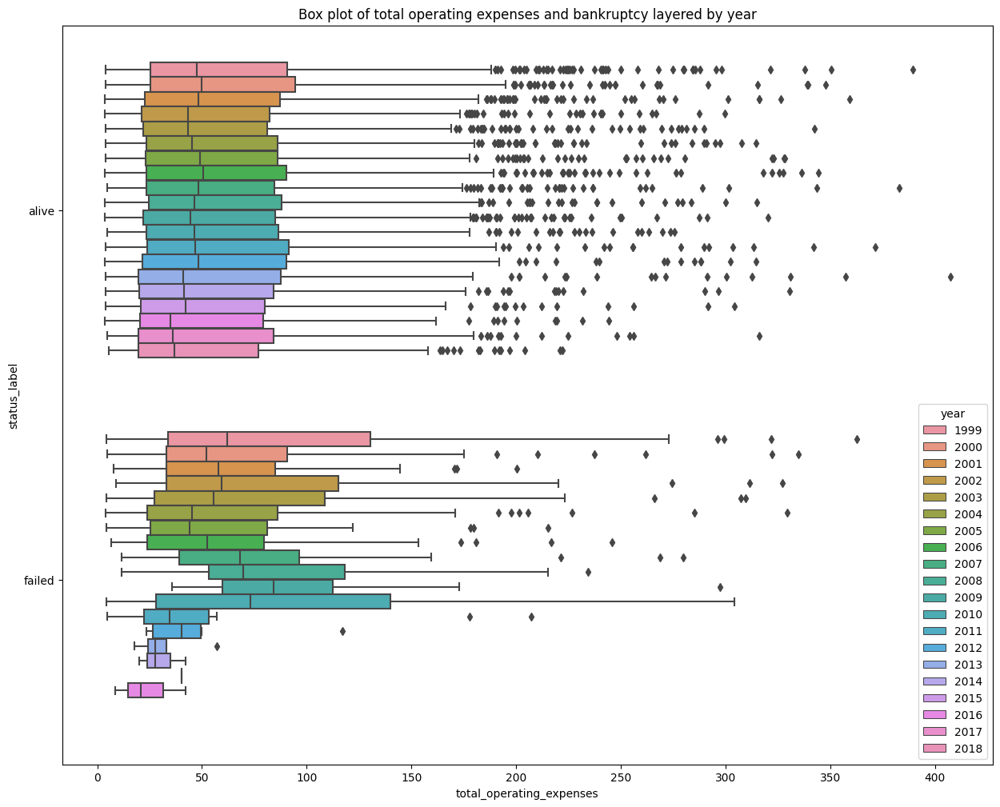

In [42]:
plt.figure(figsize=(15,12))
sns.boxplot(data=df1, x= 'total_operating_expenses', y='status_label', hue='year')
plt.title('Box plot of total operating expenses and bankruptcy layered by year')

# Relationship between bankruptcy and Inventory

Text(0.5, 1.0, 'Violin plot of bankruptcy and inventory layered by year')

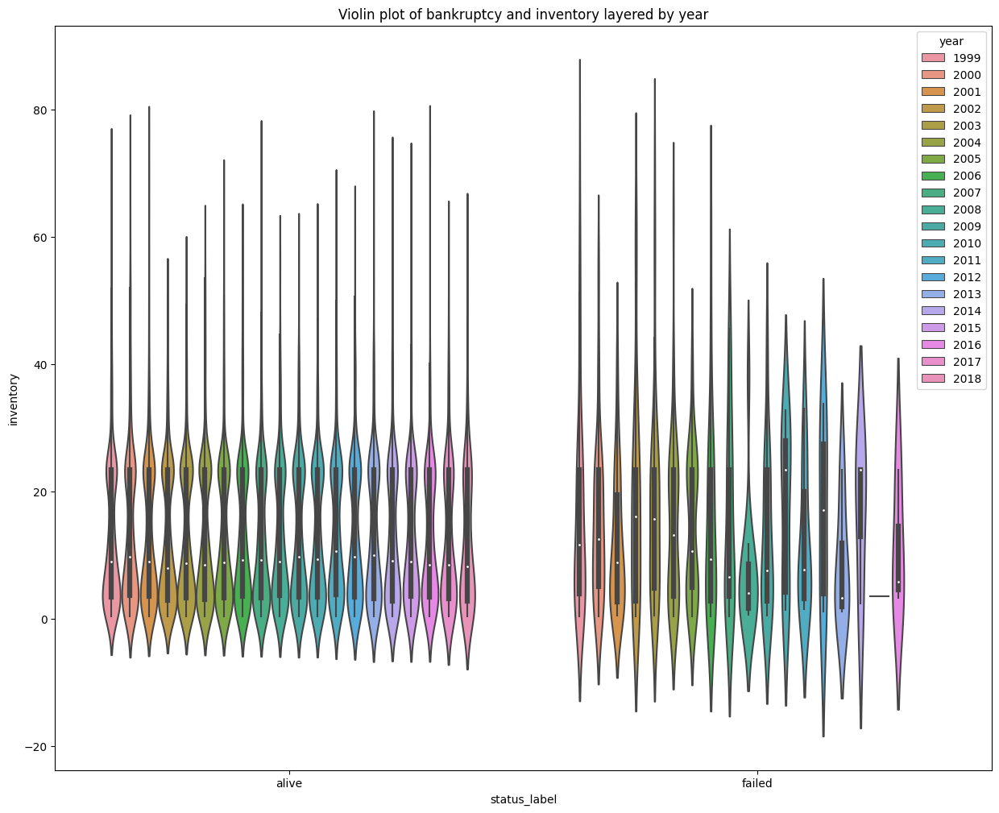

In [74]:
plt.figure(figsize=(15,12))
sns.violinplot(data=df1, x= 'status_label', y='inventory', hue= "year")
plt.title('Violin plot of bankruptcy and inventory layered by year')

# Relationship between bankruptcy and EBIT

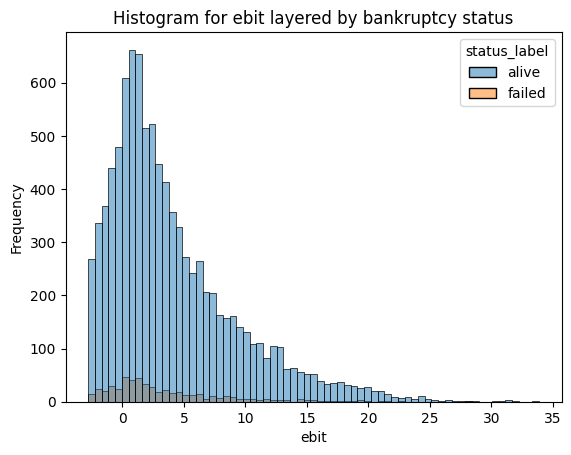

In [76]:
sns.histplot(data=df1, x='ebit', hue= 'status_label')
plt.title('Histogram for ebit layered by bankruptcy status')
plt.xlabel('ebit')
plt.ylabel('Frequency')
plt.show()

# Extracting the file to visualize in power BI after cleaning

In [584]:
df1.to_csv('df1_extracted.csv', index=False)

# Chapter 3: Feature engineering

# Variable Encoding

In [33]:
df1

,company_name,status_label,year,current_assets,cogs,depreciation_&_amortization,ebitda,inventory,net_income,total_receivables,...,net_sales,total_assets,longterm_debt,ebit,gross_profit,current_liabilities,retained_earnings,total_revenue,total_liabilities,total_operating_expenses
0,C_3,alive,2000,7.884,16.506,0.700,0.672,4.078,-0.808,3.244,...,25.367,11.608,4.8750,-0.028,8.861,2.278,-7.184,25.367,7.153,24.695
1,C_3,alive,2004,5.807,12.018,0.160,1.614,2.704,1.345,2.504,...,19.833,6.245,0.2220,1.454,7.815,3.222,-8.974,19.833,3.580,18.219
2,C_3,alive,2005,7.726,14.013,0.177,1.856,3.921,1.900,2.704,...,23.135,8.153,58.9395,1.679,9.122,3.375,-7.073,23.135,3.490,21.279
3,C_3,alive,2006,13.582,15.454,0.216,1.252,4.835,1.005,2.757,...,24.998,14.341,58.9395,1.036,9.544,3.600,-5.977,24.998,3.672,23.746
4,C_3,alive,2007,13.454,17.589,0.500,-0.432,6.395,-4.673,5.031,...,28.720,27.171,5.8220,-0.932,11.131,6.259,-10.708,28.720,12.296,29.152
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10041,C_8942,alive,2018,2.169,5.792,0.541,-1.140,23.397,-2.934,1.688,...,8.217,3.780,0.4330,-1.681,2.425,7.522,-24.406,8.217,8.018,9.357
10042,C_8944,alive,2007,49.985,99.958,7.056,6.327,37.820,0.323,1.176,...,193.936,82.424,0.3210,-0.729,93.978,25.775,-8.808,193.936,32.072,187.609
10043,C_8965,alive,2012,41.875,9.535,1.187,9.066,23.397,10.653,1.542,...,39.127,47.712,0.2370,7.879,29.592,24.251,-13.412,39.127,31.755,30.061
10044,C_8965,alive,2013,65.839,12.959,1.645,21.147,23.397,6.260,3.180,...,64.757,78.350,0.7670,19.502,51.798,39.533,-7.261,64.757,53.405,43.610


In [34]:
encoder= LabelEncoder()

df1['status_label']= encoder.fit_transform(df1['status_label'])

In [35]:
df1.status_label.value_counts()

0    9520
1     526
Name: status_label, dtype: int64

In [36]:
df1.columns

Index(['company_name', 'status_label', 'year', 'current_assets', 'cogs',
       'depreciation_&_amortization', 'ebitda', 'inventory', 'net_income',
       'total_receivables', 'market_value', 'net_sales', 'total_assets',
       'longterm_debt', 'ebit', 'gross_profit', 'current_liabilities',
       'retained_earnings', 'total_revenue', 'total_liabilities',
       'total_operating_expenses'],
      dtype='object')

# Segregating features and target variables

In [38]:
X= df1[['current_assets', 'cogs',
       'depreciation_&_amortization', 'ebitda', 'inventory', 'net_income',
       'total_receivables', 'market_value', 'net_sales', 'total_assets',
       'longterm_debt', 'ebit', 'gross_profit', 'current_liabilities',
       'retained_earnings', 'total_revenue', 'total_liabilities',
       'total_operating_expenses']]
Y= df1['status_label']

In [39]:
print(X,Y)

       current_assets    cogs  depreciation_&_amortization  ebitda  inventory  \
0               7.884  16.506                        0.700   0.672      4.078   
1               5.807  12.018                        0.160   1.614      2.704   
2               7.726  14.013                        0.177   1.856      3.921   
3              13.582  15.454                        0.216   1.252      4.835   
4              13.454  17.589                        0.500  -0.432      6.395   
...               ...     ...                          ...     ...        ...   
10041           2.169   5.792                        0.541  -1.140     23.397   
10042          49.985  99.958                        7.056   6.327     37.820   
10043          41.875   9.535                        1.187   9.066     23.397   
10044          65.839  12.959                        1.645  21.147     23.397   
10045          86.998  21.099                        4.173  16.901     23.397   

       net_income  total_re

# Feature selection

# Principle component analysis

In [61]:
from sklearn.decomposition import PCA

In [62]:
pca= PCA(0.95)

In [63]:
X_pca= pca.fit_transform(X)
X_pca.shape

(10046, 5)

In [64]:
pca.explained_variance_ratio_

array([0.60456646, 0.27858427, 0.04097107, 0.02278308, 0.01828191])

In [65]:
pca.n_components_

5

# Correlation method

<Axes: >

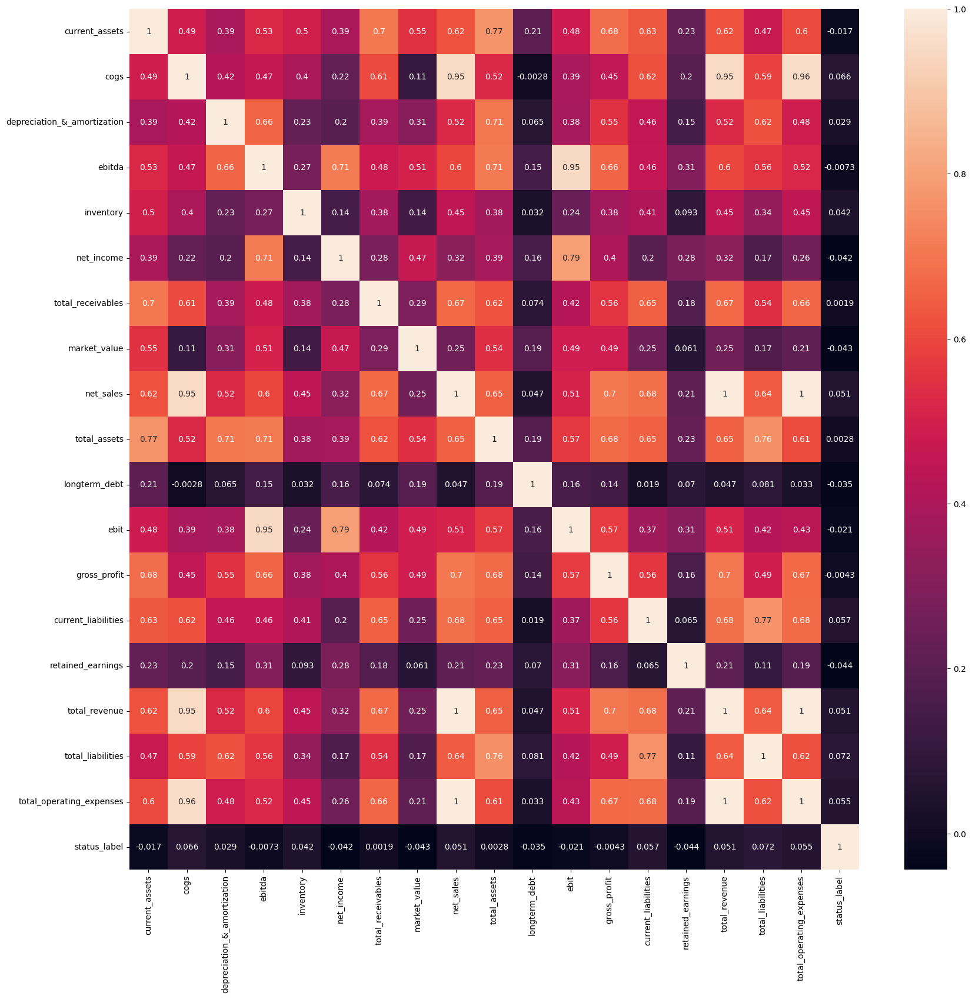

In [67]:
plt.figure(figsize=(20,19))
sns.heatmap(df1[['current_assets', 'cogs',
       'depreciation_&_amortization', 'ebitda', 'inventory', 'net_income',
       'total_receivables', 'market_value', 'net_sales', 'total_assets',
       'longterm_debt', 'ebit', 'gross_profit', 'current_liabilities',
       'retained_earnings', 'total_revenue', 'total_liabilities',
       'total_operating_expenses','status_label']].corr(), annot= True)

# We will take cogs, current_liabilities, total_revenue, total_liabilities and total_operating_expenses as our features since we have been provided with the optimal number of features to be 5 by the PCA analysis, they are the 5 most correlated to the target variable/ variable of interest

# Checking for multicollinearity among the variables

<Axes: >

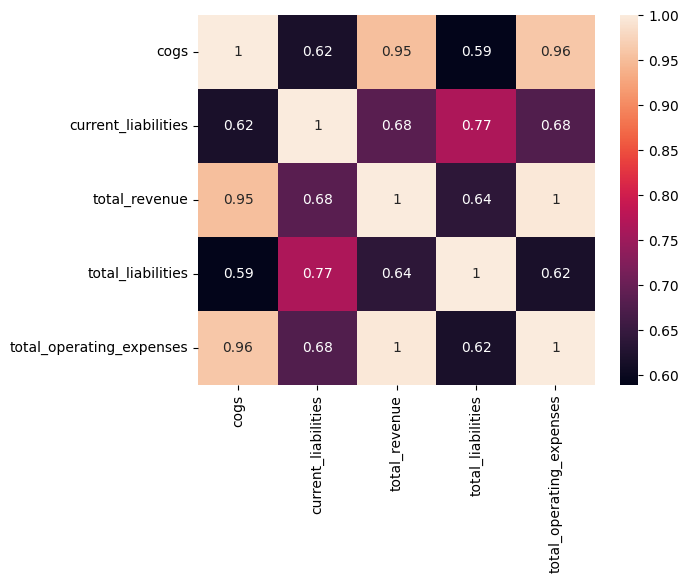

In [68]:
sns.heatmap(df1[['cogs','current_liabilities','total_revenue', 'total_liabilities', 'total_operating_expenses']].corr(), annot= True)

# Chapter 4: Preparation for Machine Learning modelling

# Splitting the features and target into test and train data 

In [69]:

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size= 0.2, random_state=2)

In [70]:
print(X.shape, X_train.shape, X_test.shape)

(10046, 18) (8036, 18) (2010, 18)


In [71]:
X_train

,current_assets,cogs,depreciation_&_amortization,ebitda,inventory,net_income,total_receivables,market_value,net_sales,total_assets,longterm_debt,ebit,gross_profit,current_liabilities,retained_earnings,total_revenue,total_liabilities,total_operating_expenses
9797,18.903,71.821,0.181,2.042,23.397,1.113,11.925,13.3132,89.362,19.788,58.9395,1.861,17.541,6.741,3.462,89.362,6.741,87.320
2312,18.613,33.785,3.588,12.370,6.787,2.862,6.834,36.9272,58.090,43.498,15.8130,8.782,24.305,6.914,-15.517,58.090,25.752,45.720
8768,92.613,36.989,1.321,15.030,34.336,12.974,23.385,183.4410,63.686,126.483,58.9395,13.709,26.697,48.255,34.063,63.686,48.645,48.656
6008,21.449,6.270,10.596,13.974,23.397,2.129,7.213,55.4902,26.368,41.395,58.9395,3.378,20.098,7.518,-24.144,26.368,7.518,12.394
3951,3.410,3.259,0.137,2.676,0.679,1.492,1.925,6.9886,8.779,4.407,3.8940,2.539,5.520,1.995,-21.925,8.779,6.043,6.103
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1099,10.755,10.287,0.215,-1.426,5.841,-1.867,2.750,9.5218,18.048,11.161,58.9395,-1.641,7.761,3.475,-5.772,18.048,3.768,19.474
2514,12.294,25.680,0.162,-1.038,1.131,-1.130,3.902,7.4493,30.600,12.964,58.9395,-1.200,4.920,1.636,7.816,30.600,1.667,31.638
6637,27.540,22.671,0.103,1.828,2.449,1.541,6.069,40.2534,30.608,27.782,58.9395,1.725,7.937,2.832,10.431,30.608,2.832,28.780
2575,29.931,12.117,0.597,11.803,3.153,7.905,3.905,116.0566,28.952,45.986,3.6890,11.206,16.835,3.165,38.750,28.952,7.197,17.149


# Chapter 5: Predictive analysis using machine learning models

# "Model": Logistic regression

In [173]:
model= LogisticRegression()

In [174]:
model.fit(X_train,Y_train)

LogisticRegression()

ACCURACY CHECK on Train and test data

In [175]:
model.score(X_train,Y_train)

0.9473618715778994

In [176]:
model.score(X_test,Y_test)

0.9487562189054727

# Actual prediction

In [31]:
nepali_companies= pd.read_csv('nepali_companies.csv') 

In [32]:
nepali_companies.head()

,current_assets,cogs,depreciation_&_amortization,ebitda,inventory,net_income,total_receivables,market_value,net_sales,total_assets,longterm_debt,ebit,gross_profit,current_liabilities,retained_earnings,total_revenue,total_liabilities,total_operating_expenses
0,4251.3,9571.7,367.4,3907.6,2953.8,2262.0,979.6,40077.5,9236.0,1434.3,3540.2,40279.6,8361.6,2824.2,1637.5,40279.6,3109.3,4454.2
1,5736.8,10904.7,429.0,6274.2,2320.3,4131.1,3101.4,49540.6,10727.0,1280.6,5845.1,49144.0,12100.3,2874.9,1688.3,49144.0,3123.2,6229.3
2,10747.5,8389.0,382.2,5439.0,3277.7,3591.7,7012.1,71227.8,15350.9,1171.9,5056.8,36669.7,9500.4,5474.2,2030.4,36669.7,5716.8,4068.8
3,13099.4,10271.2,393.0,11357.2,1268.9,8010.7,3977.9,380454.1,17766.6,11.4,10964.2,50054.5,17115.0,2072.5,5785.9,50054.5,2346.6,6318.9
4,19702.1,10360.1,421.8,11359.4,1594.8,8130.3,8850.6,398308.8,24556.8,94.1,10937.6,58331.0,19128.9,2355.7,6461.7,58331.0,2675.2,7810.6


In [180]:
logistic_pred= model.predict(nepali_companies)

In [181]:
print(logistic_pred)

[1 1 1 1 1 1 1 1 1 1 1]


In [182]:
for i, prediction in enumerate(logistic_pred):
    if prediction == 0:
        print(f"Company {i+1}: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt")
    else:
        print(f"Company {i+1}: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt")

Company 1: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 2: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 3: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 4: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 5: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 6: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 7: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 8: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 9: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 10: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 11: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt


# “Model 1”: Naïve Bayes classification algorithm

In [183]:

model1 = GaussianNB()

In [184]:
model1.fit(X_train, Y_train)

GaussianNB()

# Accuracy on train and test data

In [185]:
model1.score(X_train, Y_train)

0.8780487804878049

In [186]:
model1.score(X_test, Y_test)

0.8835820895522388

# Actual prediction

In [134]:
naive_pred= model1.predict(nepali_companies)

In [135]:


for i, prediction in enumerate(naive_pred):
    if prediction == 0:
        print(f"Company {i+1}: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt")
    else:
        print(f"Company {i+1}: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt")

Company 1: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 2: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 3: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 4: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 5: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 6: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 7: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 8: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 9: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 10: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 11: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt


# “Model2”: K Nearest neighbor

In [136]:
model2= KNeighborsClassifier(n_neighbors=3)

In [137]:
model2.fit(X_train, Y_train)

KNeighborsClassifier(n_neighbors=3)

# Accuracy score on train and test data

In [138]:
model2.score(X_train, Y_train)

0.9695121951219512

In [139]:
model2.score(X_test, Y_test)

0.9482587064676616

# Actual prediction

In [140]:
knn_pred= model2.predict(nepali_companies)

In [141]:
for i, prediction in enumerate(knn_pred):
    if prediction == 0:
        print(f"Company {i+1}: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt")
    else:
        print(f"Company {i+1}: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt")

Company 1: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 2: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 3: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 4: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 5: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 6: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 7: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 8: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 9: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 10: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 11: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt


# "Model 3": Decision Tree Algorithm

In [142]:
model3= tree.DecisionTreeClassifier(max_depth=3)

In [143]:
model3.fit(X_train, Y_train)

DecisionTreeClassifier(max_depth=3)

# Accuracy on train and test data

In [144]:
model3.score(X_train, Y_train)

0.9481085116973619

In [145]:
model3.score(X_test, Y_test)

0.9472636815920398

# Actual prediction

In [147]:
Tree_pred= model3.predict(nepali_companies)

In [148]:
for i, prediction in enumerate(Tree_pred):
    if prediction == 0:
        print(f"Company {i+1}: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt")
    else:
        print(f"Company {i+1}: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt")

Company 1: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 2: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 3: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 4: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 5: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 6: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 7: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 8: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 9: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 10: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt
Company 11: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt


# Visualization of decision tree

In [149]:
from sklearn.tree import plot_tree

# Note: It takes a lot of time for the following code to visualize the decision tree.

# PLEASE BE PATIENT

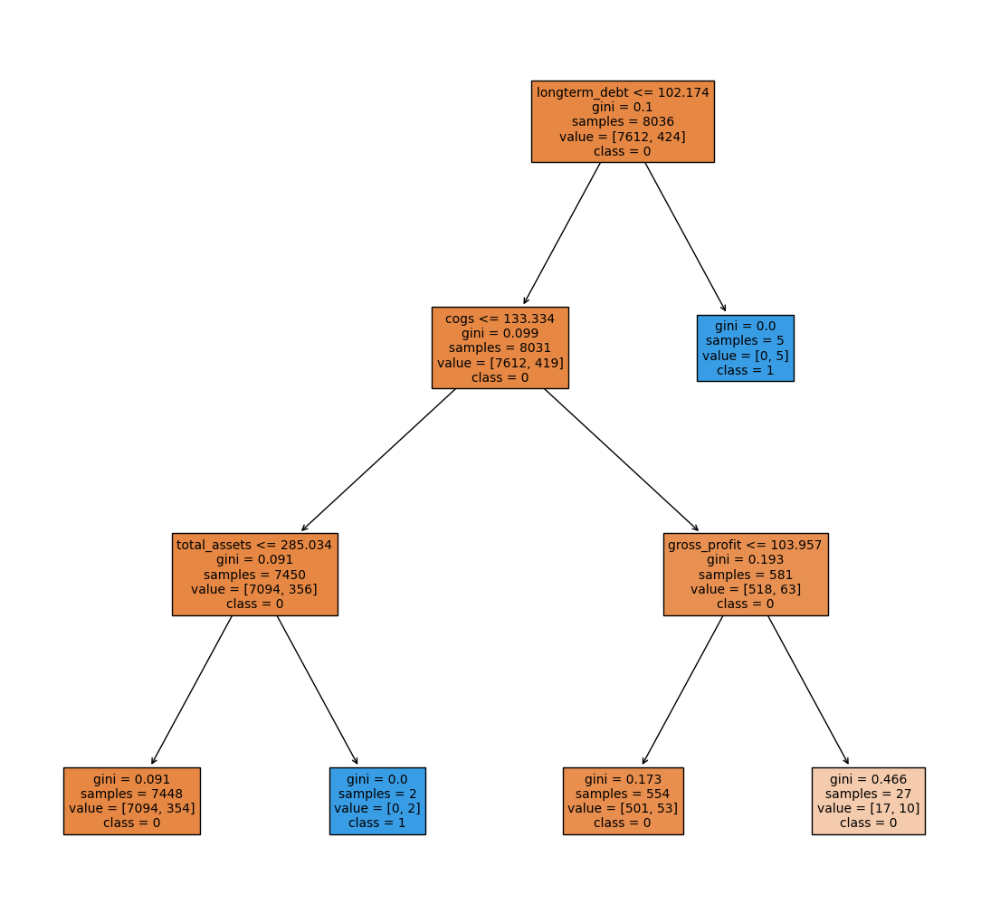

In [150]:
plt.figure("Decision Tree", figsize=[14,13])
class_names = Y.unique().astype(str)
tree.plot_tree(model3, fontsize=10, filled=True, feature_names=X.columns, class_names=class_names)
plt.show()


# Model 4: Support vector machines Algorithm

In [151]:
model4= SVC()

In [152]:
model4.fit(X_train, Y_train)

SVC()

# Accuracy on train and test data

In [153]:
model4.score(X_train, Y_train)

0.947237431557989

In [154]:
model4.score(X_test, Y_test)

0.9492537313432836

# Or alternatively,

In [155]:
X_train_pred= model4.predict(X_train)

In [156]:
train_accuracy= accuracy_score(Y_train, X_train_pred)

In [157]:
print("Accuracy of training data is :", train_accuracy)

Accuracy of training data is : 0.947237431557989


# ACCURACY CHECK on Test data

In [158]:
X_test_pred= model4.predict(X_test)

In [159]:
test_accuracy= accuracy_score(Y_test,X_test_pred)

In [160]:
print("Accuracy of test data is :", test_accuracy)

Accuracy of test data is : 0.9492537313432836


# Evaluation and Visualization of SVM Model

In [161]:
from sklearn.metrics import confusion_matrix
cm= confusion_matrix(Y_test, X_test_pred)

Text(0.5, 1.0, 'Confusion Matrix')

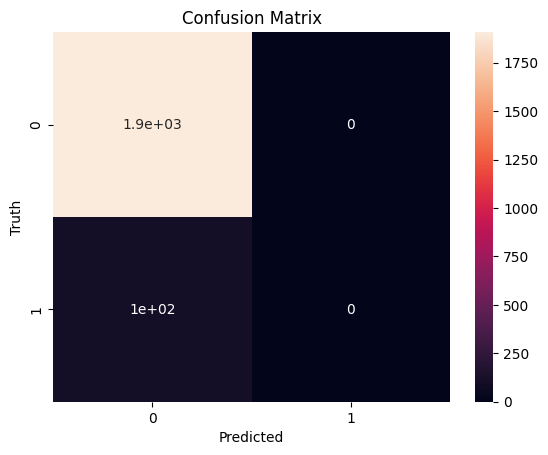

In [162]:
sns.heatmap(cm, annot= True)
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.title('Confusion Matrix')

# Actual prediction

In [164]:
svc_pred= model4.predict(nepali_companies)

In [165]:
for i, prediction in enumerate(svc_pred):
    if prediction == 0:
        print(f"Company {i+1}: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt")
    else:
        print(f"Company {i+1}: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt")

Company 1: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 2: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 3: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 4: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 5: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 6: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 7: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 8: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 9: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 10: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 11: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt


# "Model 5": Random forest classifier

In [203]:
model5 = RandomForestClassifier(n_estimators=5, random_state=42)

In [204]:
model5.fit(X_train, Y_train)

RandomForestClassifier(n_estimators=5, random_state=42)

# Accuracy check on train and test data

In [205]:
model5.score(X_train, Y_train)

0.9911647585863613

In [206]:
model5.score(X_test, Y_test)

0.9502487562189055

# Actual prediction

In [207]:
random_pred= model5.predict(nepali_companies)

In [208]:
for i, prediction in enumerate(random_pred):
    if prediction == 0:
        print(f"Company {i+1}: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt")
    else:
        print(f"Company {i+1}: Alternative hypothesis is accepted i.e., The company is likely to go bankrupt")

Company 1: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 2: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 3: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 4: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 5: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 6: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 7: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 8: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 9: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 10: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt
Company 11: Null hypothesis is accepted i.e., The company is unlikely to go bankrupt


# Visualization of Random forest model

# Note: It takes a lot of time for the following code to visualize the random forest trees. 
# PLEASE BE PATIENT

In [209]:
import math

estimators = model5.estimators_
num_estimators = len(estimators)
num_rows = math.ceil(math.sqrt(num_estimators))
num_cols = math.ceil(num_estimators / num_rows)

fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(40, 38), dpi=300)

for i, ax in enumerate(axes.flatten()):
    if i < num_estimators:
        ax.set_title('Tree {}'.format(i + 1))
        tree.plot_tree(estimators[i], ax=ax, fontsize=6, filled=True, feature_names=X.columns)
    else:
        fig.delaxes(ax)

plt.tight_layout()
plt.show()

# Chapter 6: Selection of the best model

# Cross validation(Stratified K fold method)

In [187]:
from sklearn.model_selection import StratifiedKFold
folds= StratifiedKFold(n_splits=5)

In [188]:
from sklearn.model_selection import cross_val_score

# Calculating the cross validation score and standard deviation between the folds for each model

# For "Model": Logistic regression

In [189]:
cross_val_score(model, X, Y)

array([0.94626866, 0.94773519, 0.94723743, 0.94773519, 0.94773519])

In [190]:
std_model = np.array([0.94726368, 0.94773519, 0.94723743, 0.94823295, 0.94773519])
std_dev = np.std(std_model)

print(std_dev)

0.0003669842991954452


# For "Model 1": Naive Bayesian regression

In [191]:
cross_val_score(model1, X, Y)

array([0.87014925, 0.89795918, 0.87108014, 0.8865107 , 0.84619214])

In [192]:
std_model1 = np.array([0.87014925, 0.89845694, 0.87108014, 0.8865107 , 0.84619214])
std_dev1 = np.std(std_model1)

print(std_dev1)

0.017607662183024297


# For "Model 2": K Nearest neighbor

In [193]:
cross_val_score(model2, X, Y)

array([0.9318408 , 0.93230463, 0.92782479, 0.92384271, 0.92732703])

In [194]:
std_model2 = np.array([0.9318408 , 0.93230463, 0.92782479, 0.92384271, 0.92732703])
std_dev2 = np.std(std_model2)

print(std_dev2)

0.003132933501550273


# For “Model 3”: Decision tree

In [195]:
cross_val_score(model3, X, Y)

array([0.94726368, 0.94773519, 0.94425087, 0.94673967, 0.94425087])

In [196]:
std_model3 = np.array([0.94726368, 0.94773519, 0.94425087, 0.94673967, 0.94425087])
std_dev3 = np.std(std_model3)

print(std_dev3)

0.0015008162982537375


# For “Model 4”: Support vector machine

In [197]:
cross_val_score(model4, X, Y)

array([0.94726368, 0.94773519, 0.94773519, 0.94773519, 0.94773519])

In [198]:
std_model4 = np.array([0.94726368, 0.94773519, 0.94773519, 0.94773519, 0.94773519])
std_dev4 = np.std(std_model4)

print(std_dev4)

0.00018860399999995892


# For “Model 5”: Random forest classifier

In [199]:
cross_val_score(model5, X, Y)

array([0.94378109, 0.94425087, 0.93628671, 0.93977103, 0.93927327])

In [200]:
std_model5 = np.array([0.94378109, 0.94425087, 0.93628671, 0.93977103, 0.93927327])
std_dev5 = np.std(std_model5)

print(std_dev5)

0.0029824054143834946


# Visualization of std deviation of models across the folds

In [201]:
std_scores = [0.0003669842991954452,0.017607662183024297,0.003132933501550273,0.0015008162982537375,0.00018860399999995892,0.0029824054143834946]
score_names = ['Logistic_std', 'Naive_std','KNN_std', 'DTree_std', 'SVM_std', 'Rforest_std']
best_model = pd.DataFrame({'Standard Deviation': std_scores}, index=score_names)
print(best_model)

              Standard Deviation
Logistic_std            0.000367
Naive_std               0.017608
KNN_std                 0.003133
DTree_std               0.001501
SVM_std                 0.000189
Rforest_std             0.002982


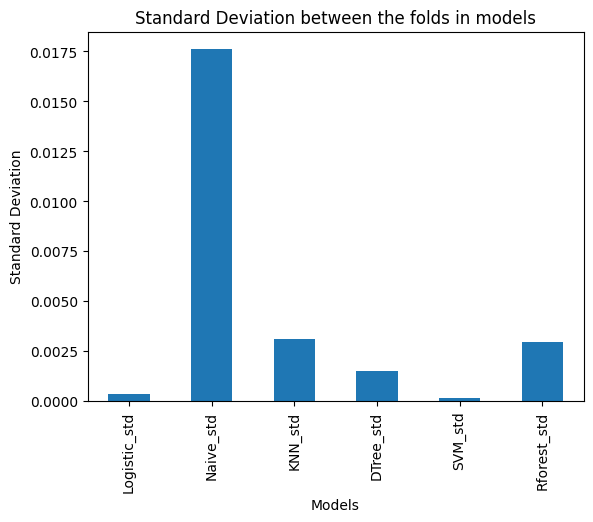

In [202]:
best_model.plot(kind='bar', legend=None)
plt.xlabel('Models')
plt.ylabel('Standard Deviation')
plt.title('Standard Deviation between the folds in models')
plt.show()

# SVM has the LOWEST standard deviation accross the folds. . We will be choosing the SVM model.